In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp

from matplotlib.pyplot import rc_context
from matplotlib.pyplot import rcParams
from matplotlib import colors
from matplotlib.colors import ListedColormap

import gseapy as gp
from gseapy.plot import barplot, dotplot, gseaplot, heatmap

import besca as bc
import pytest

from matplotlib_venn import venn2, venn3, venn2_circles, venn3_circles


# sc.set_figure_params(figsize=(5,5))

sc.logging.print_header()

Global seed set to 0
/data/laura.garcia/miniconda3/lib/python3.8/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/data/laura.garcia/miniconda3/lib/python3.8/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)
2023-05-11 08:49:46.713323: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_L

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.2 scikit-learn==1.2.0 statsmodels==0.13.5 python-igraph==0.10.2 pynndescent==0.5.8


In [2]:
#Define a nice colour map for gene expression
grey = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
reds = plt.cm.Reds(np.linspace(0, 1, 128))
colorsComb_reds = np.vstack([grey, reds])
mymap_reds = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb_reds)

oranges = plt.cm.Oranges(np.linspace(0, 1, 128))
colorsComb_oranges = np.vstack([grey, oranges])
mymap_oranges = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb_oranges)

blues = plt.cm.Blues(np.linspace(0, 1, 128))
colorsComb_blues = np.vstack([grey, blues])
mymap_blues = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb_blues)


----

In [3]:
adata = sc.read('./data/3GEX_processed_cnv_control_annotated.h5ad')

Genes specific to tumour derived NPE-BL6-TD & NPE-IE


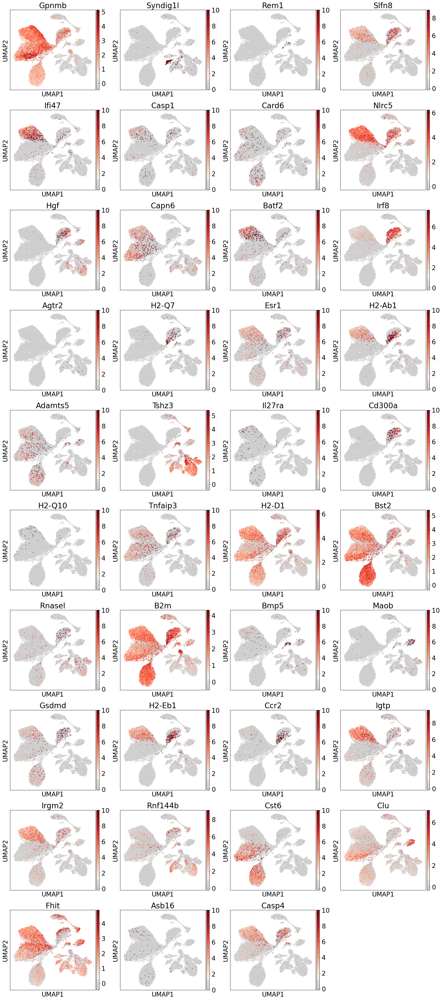

Selected chemokines


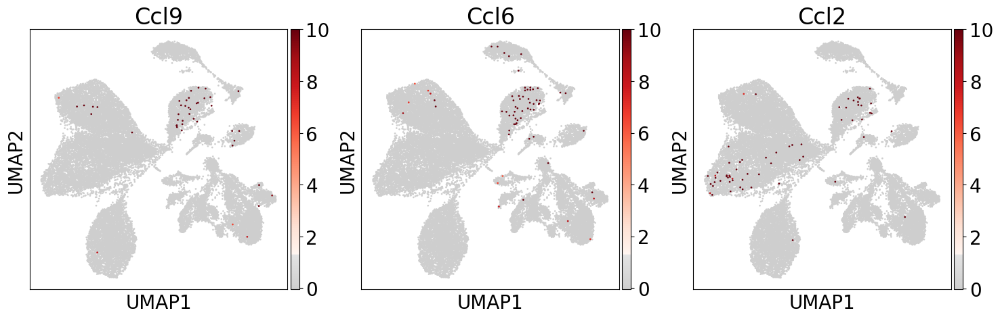

NPE-IE hypomethylated


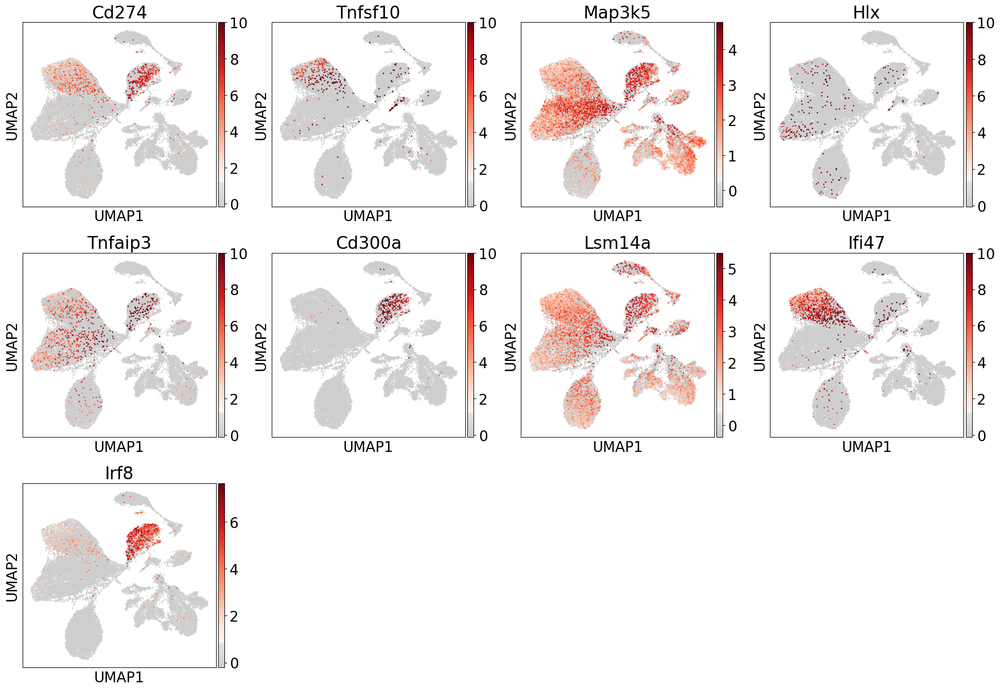

NPE-BL6-TD hypomethylated


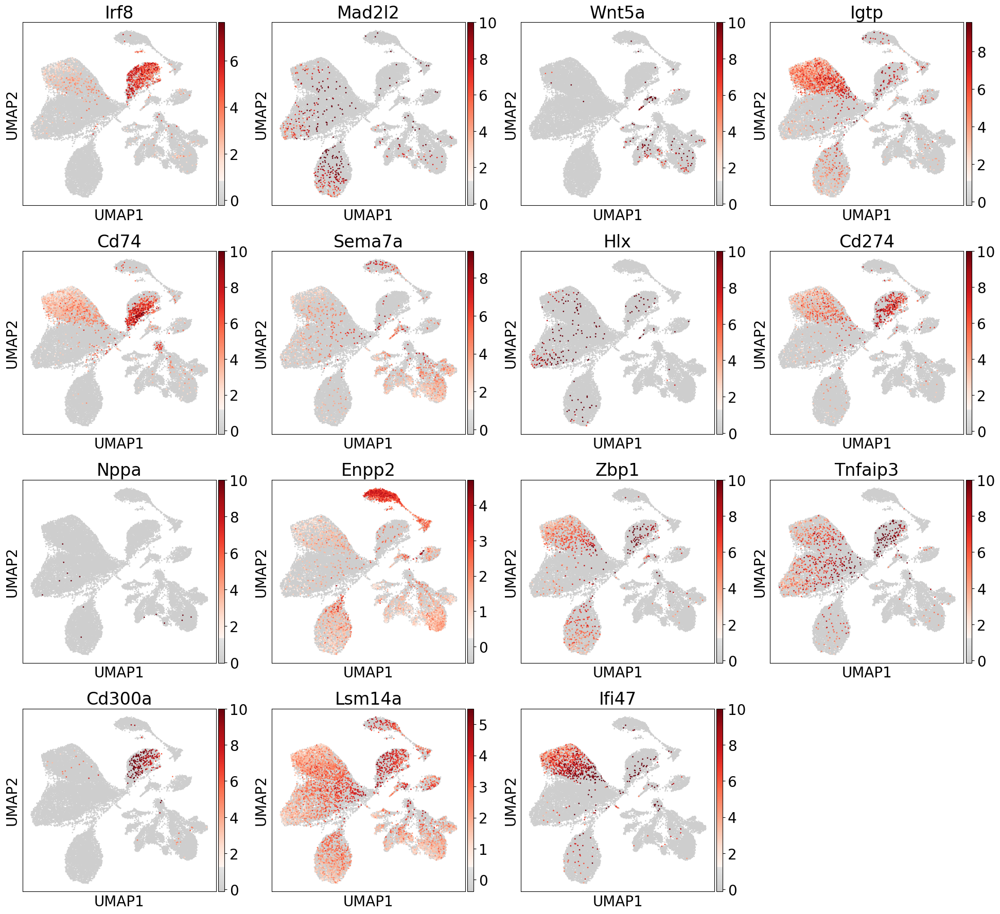

In [6]:
Gangoso = {
    'Genes specific to tumour derived NPE-BL6-TD & NPE-IE' : ['Gpnmb','Syndig1l','Rem1','Slfn8','Ifi47','Casp1','Card6','Nlrc5','Hgf','Capn6','Batf2','Irf8','Agtr2','H2-Q7','Esr1','H2-Ab1','Adamts5','Tshz3','Il27ra','Cd300a','H2-Q10','Tnfaip3','H2-D1','Bst2','Rnasel','B2m','Bmp5','Maob','Gsdmd','H2-Eb1','Ccr2','Igtp','Irgm2','Rnf144b','Cst6','H2-K2','Clu','Fhit','Asb16','Casp4'],
    'Selected chemokines' : ['Ccl9','Ccl6','Ccl2'],
    'NPE-IE hypomethylated' : ['Cd274','Tnfsf10','Map3k5','Hlx','Tnfaip3','Cd300a','Lsm14a','Ifi47','Irf8'],
    'NPE-BL6-TD hypomethylated' : ['Irf8','Mad2l2','Wnt5a','Igtp','Cd74','Sema7a','Hlx','Cd274','Nppa','Enpp2','Zbp1','Tnfaip3','Cd300a','Lsm14a','Ifi47']
}

for i in Gangoso.keys():
    print(i)
    genes_to_plot = [i for i in Gangoso[i] if i in adata.var_names]

    with rc_context({'font.size': 20.0,'figure.figsize': (5, 5)}):
        sc.pl.umap(adata, color=genes_to_plot, ncols=4, color_map=mymap_reds,
                   size=15, use_raw=False)

APC T cell activation


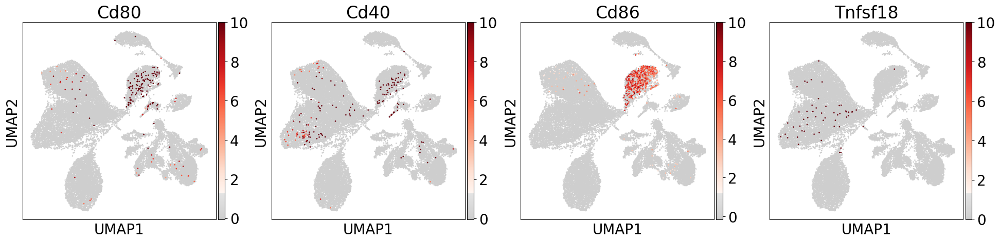

APC T cell inhibition


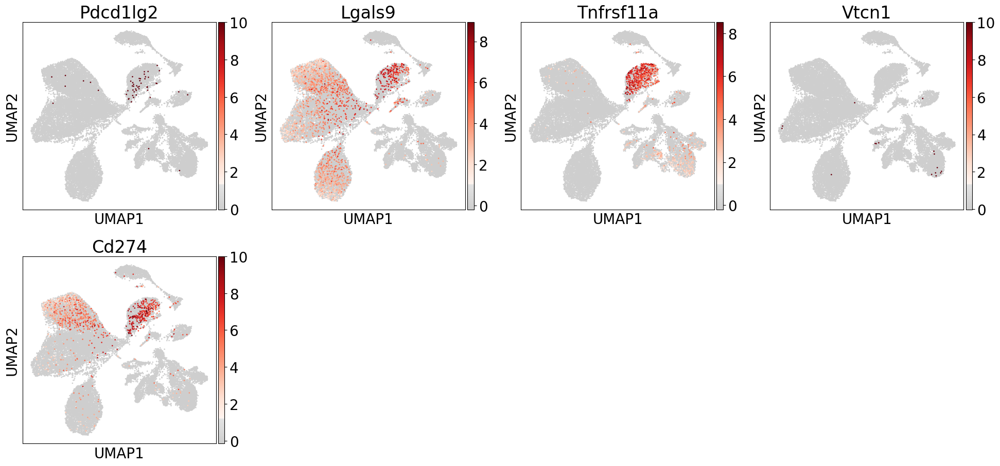

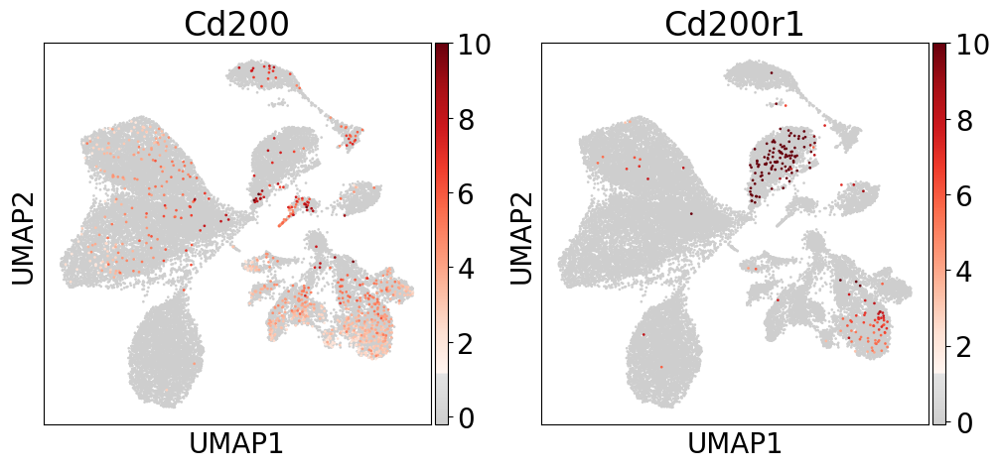

T cell activation


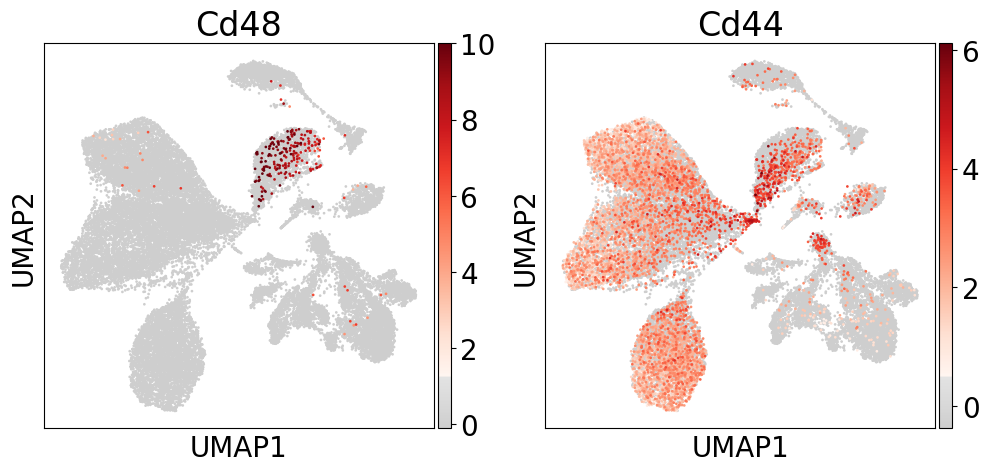

T co-activation


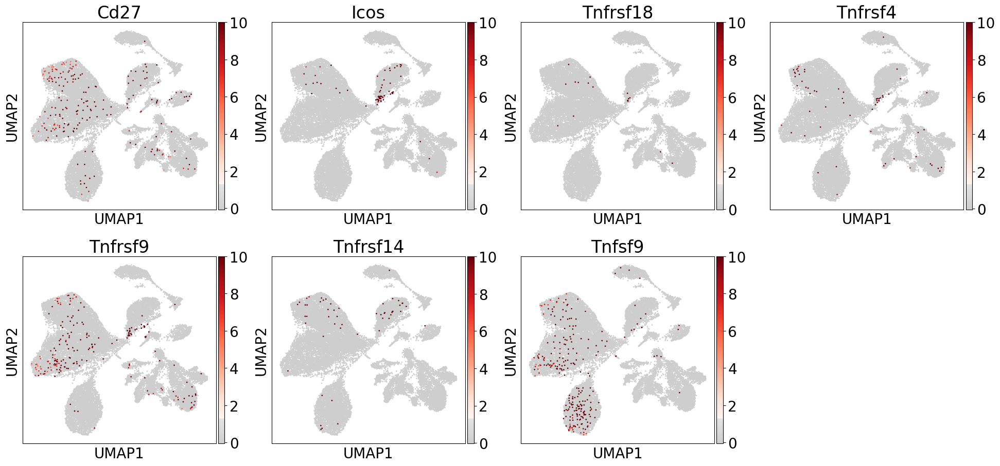

T cell inhibition


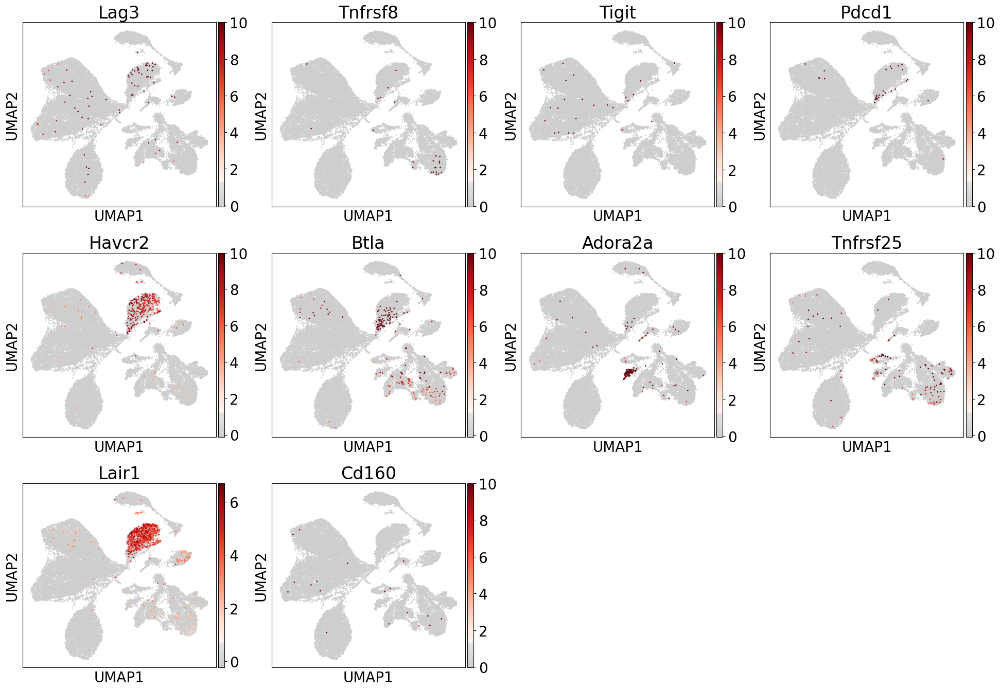

In [7]:
White = {
    'APC T cell activation': ['Tnfsf4','Cd80','Tnfsf15','Icoslg','Cd40','Cd86','Tnfsf18'],
    'APC T cell inhibition': ['Pdcd1lg2','Lgals9','Btnl2','Hhla2','Tnfrsf11a','Vtcn1','Cd274'],
    '':['Cd200','Cd200r1'],
    'T cell activation': ['Cd70','Cd244','Cd48','Cd40lg','Cd44'],
    'T co-activation':['Cd27','Icos','Tnfrsf18','Tnfrsf4','Tnfrsf9','Tnfrsf14','Tnfsf9','Tnfsf14','Tmigd2'],
    'T cell inhibition': ['Lag3','Tnfrsf8','Tigit','Pdcd1','Havcr2','Btla','Adora2a','Tnfrsf25','Lair1','Cd160']
}

for i in White.keys():
    print(i)
    genes_to_plot = [i for i in White[i] if i in adata.var_names]

    with rc_context({'font.size': 20.0,'figure.figsize': (5, 5)}):
        sc.pl.umap(adata, color=genes_to_plot, ncols=4, size=15,
                   color_map=mymap_reds, use_raw=False)

Neuroendocrine cells


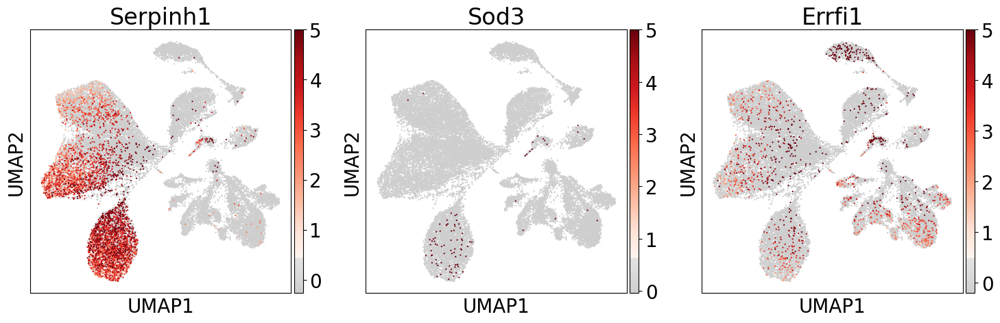

Tuft cells


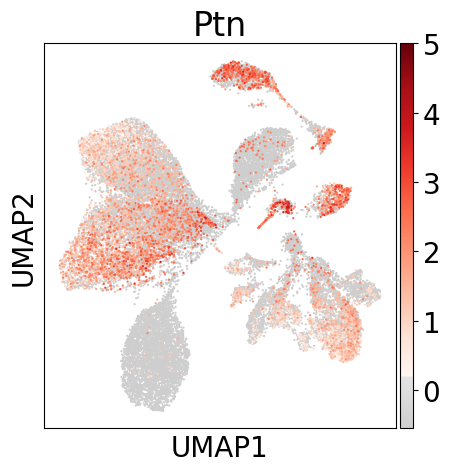

In [8]:
Yeo_heatmap = {
#     'Stem like':['Serpine2','Tnr'],
#     'Endothelial':['Slc38a2','Tspan11','Slc47a1','Col12a1','mt-Nd2','mt-Nd5','Ndrg1'],
#     'Ciliated cells':['Calml4','Ndrg2','Sox9'],
    'Neuroendocrine cells':['Serpinh1','Sod3','Errfi1'],
    'Tuft cells':['Ptn','Npi']
    
}

for i in Yeo_heatmap.keys():
    print(i)
    genes_to_plot = [i for i in Yeo_heatmap[i] if i in adata.var_names]

    with rc_context({'font.size': 20.0,'figure.figsize': (5, 5)}):
        sc.pl.umap(adata, color=genes_to_plot, ncols=4, color_map=mymap_reds,
                   size=10, vmax=5, use_raw=False)

Oligodendrocytes


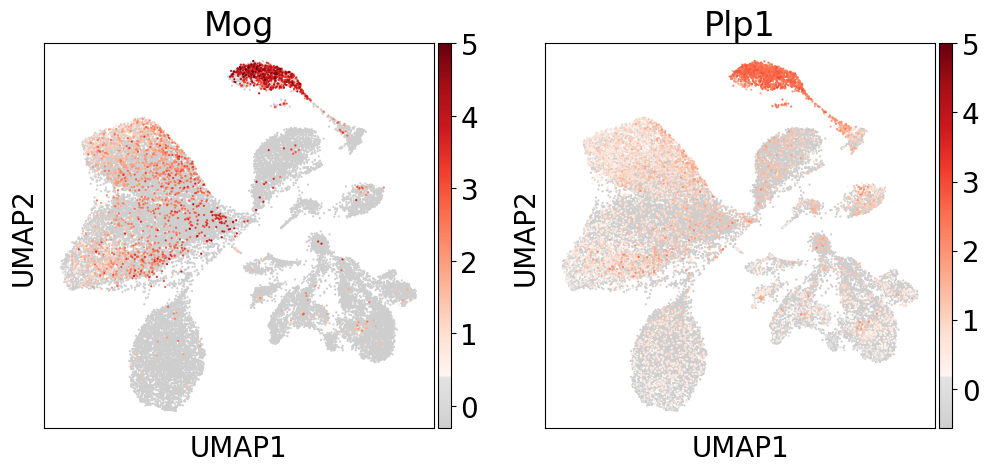

Astrocytes


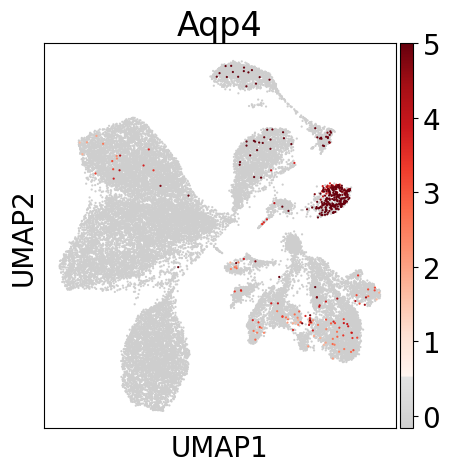

Ciliated cells


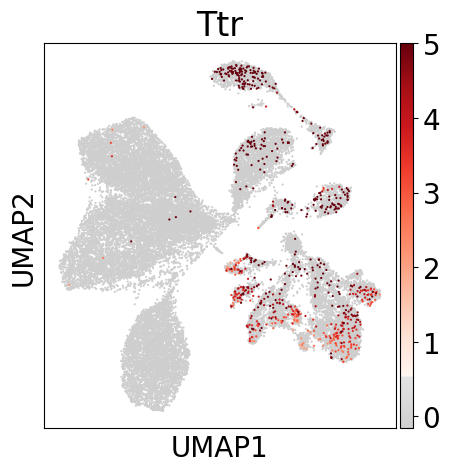

Endothelial cells


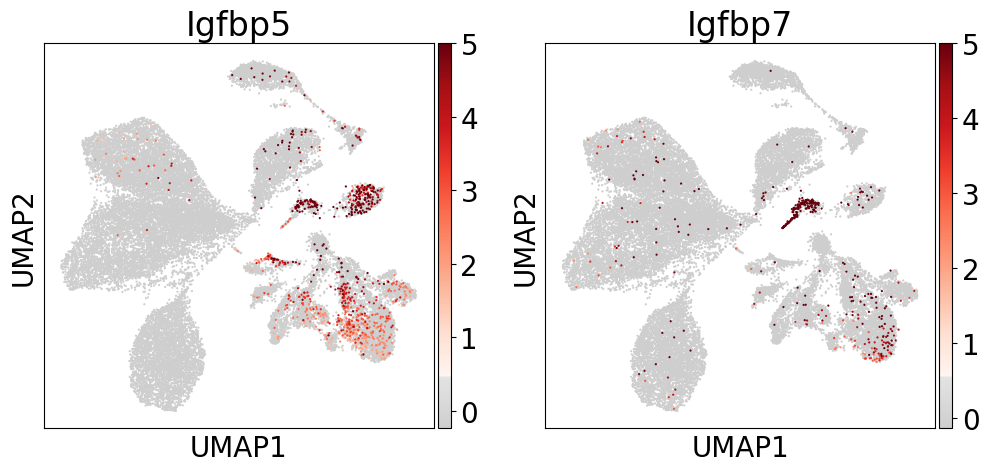

T cells


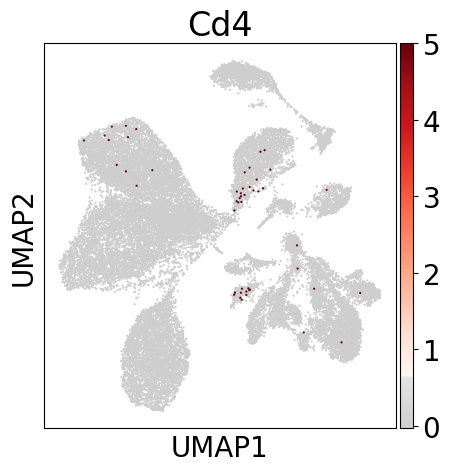

T regs


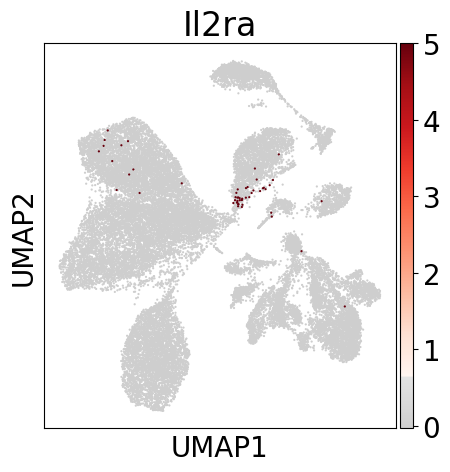

NK cells


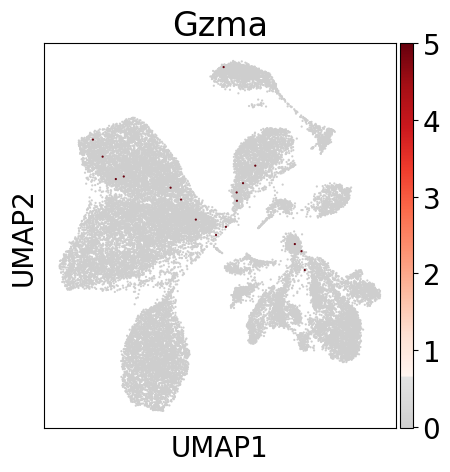

B cells


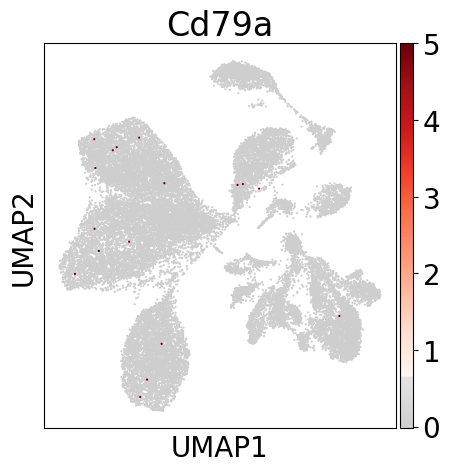

Microglia


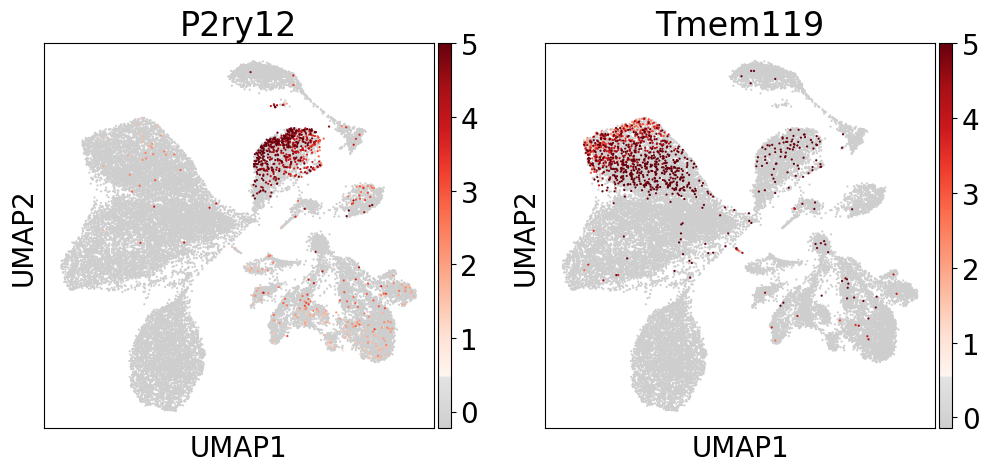

Macrophages


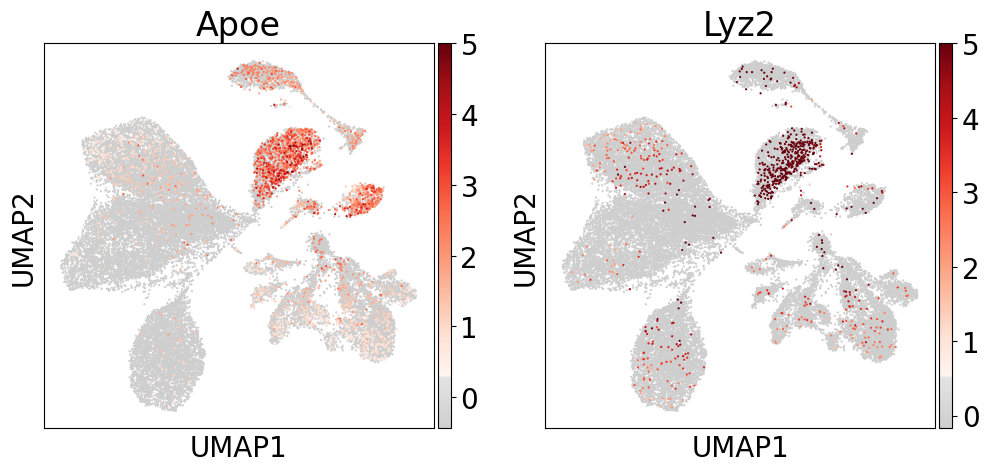

Perivascular macrophages


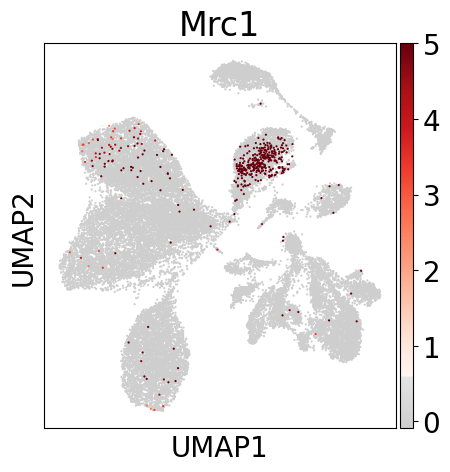

Neutrophils/MDSCs


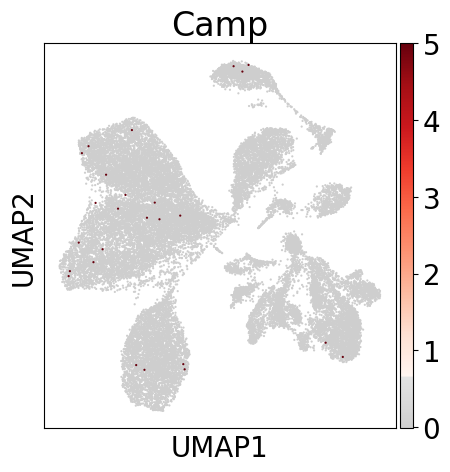

Dendritic cells


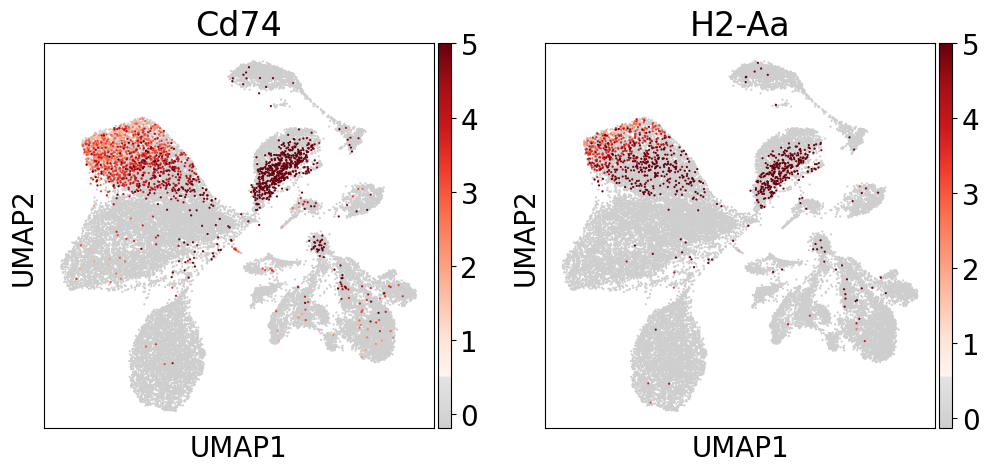

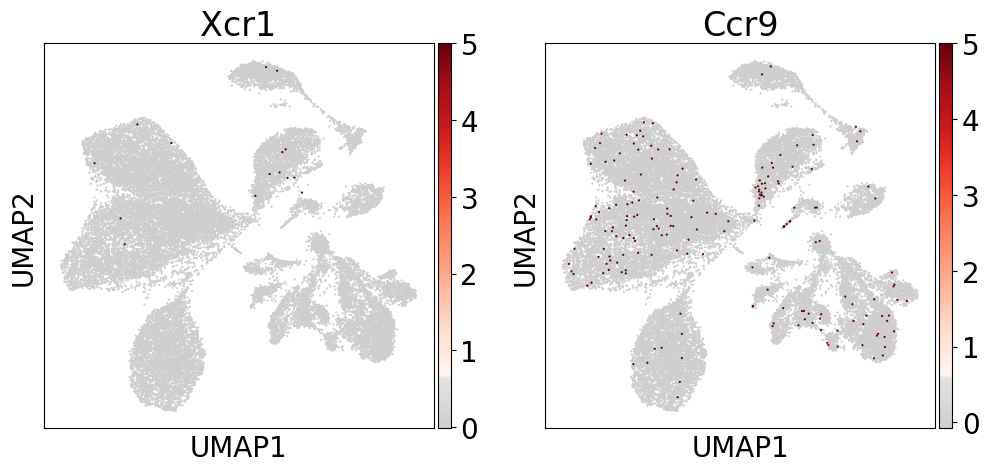

In [9]:
Yeo = {
    'Oligodendrocytes':['Mog','Plp1'],
    'Astrocytes':['Aqp4'],
    'Ciliated cells':['Ttr'],
    'Endothelial cells':['Igfbp5','Igfbp7'],
    'T cells':['Cd4','Cd8'],
    'T regs':['Il2ra'],
    'NK cells':['Gzma'],
    'B cells':['Cd79a'],
#     'Mast cells':['Cpa3'],
    'Microglia':['P2ry12','Tmem119'],
    'Macrophages':['Apoe','Lyz2'],
    'Perivascular macrophages':['Cd162','Mrc1'],
    'Neutrophils/MDSCs':['S1008a','Camp'],
    'Dendritic cells':['Cd74','H2-Aa'],
    '':['Xcr1','Ccr9'],
    
}

for i in Yeo.keys():
    print(i)
    genes_to_plot = [i for i in Yeo[i] if i in adata.var_names]

    with rc_context({'font.size': 20.0,'figure.figsize': (5, 5)}):
        sc.pl.umap(adata, color=genes_to_plot, ncols=4, color_map=mymap_reds,
                   size=10, vmax=5, use_raw=False)

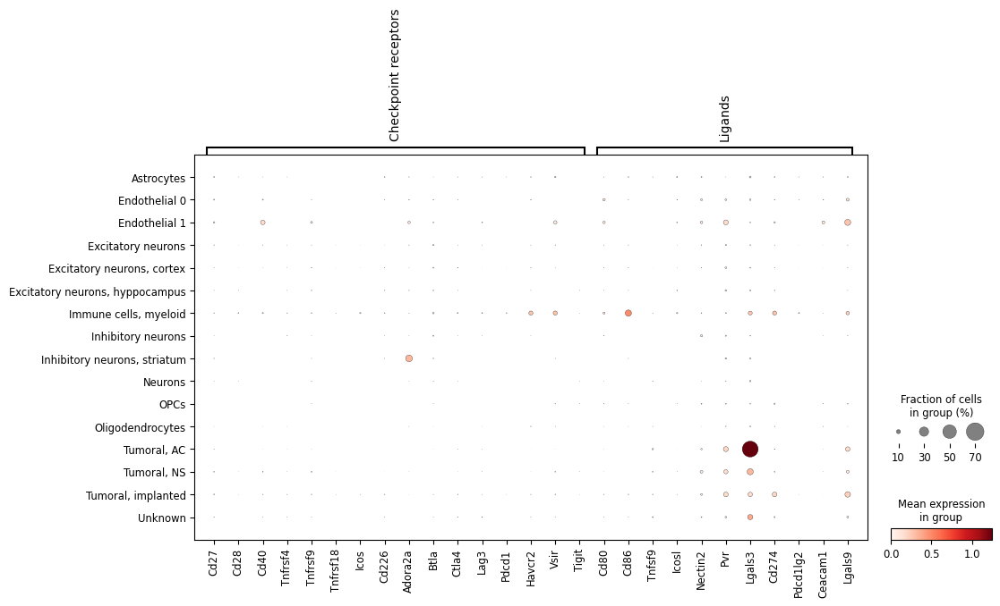

In [4]:
checkpoint ={
'Checkpoint receptors' : ['Cd27','Cd28','Cd40','Tnfrsf4','Tnfrsf9','Tnfrsf18','Icos','Cd226','Adora2a','Btla','Ctla4','Lag3','Pdcd1','Havcr2','Vsir','Tigit'],
'Ligands' : ['Cd80','Cd86','Tnfsf9','Icosl','Nectin2','Pvr','Lgals3','Cd274','Pdcd1lg2','Ceacam1','Lgals9']
}
# KeyError: "Could not find keys '['Cd40lg', 'Cd70', 'Tnfsf4']' in columns of `adata.obs` or in adata.raw.var_names."


dp = sc.pl.dotplot(adata, checkpoint, 'annotations_ref', dendrogram=False, swap_axes=False,
                  return_fig=False)
# dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()


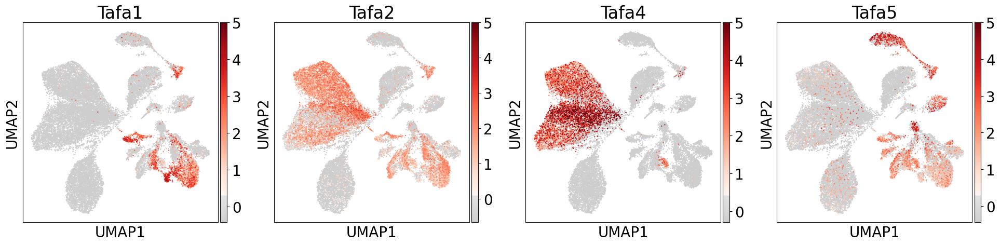

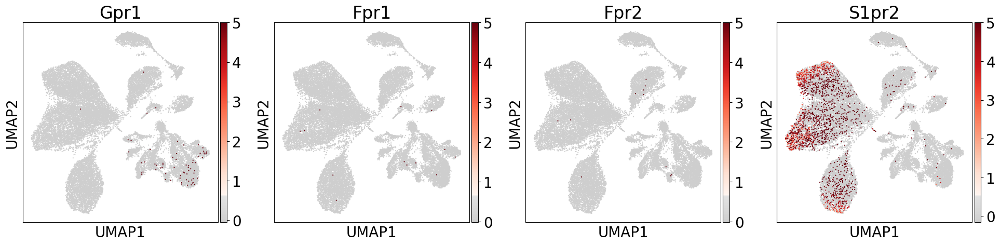

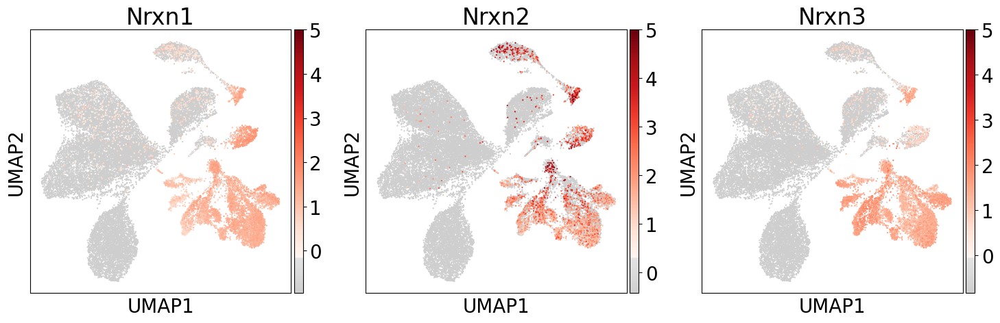

In [12]:
with rc_context({'font.size': 20.0,'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color=['Tafa1','Tafa2','Tafa4','Tafa5'], ncols=4, color_map=mymap_reds,
                   size=10, vmax=5, use_raw=False)
    sc.pl.umap(adata, color=['Gpr1','Fpr1','Fpr2','S1pr2'], ncols=4, color_map=mymap_reds, size=10, vmax=5, use_raw=False)
    sc.pl.umap(adata, color=['Nrxn1','Nrxn2','Nrxn3'], ncols=4, color_map=mymap_reds,
                   size=10, vmax=5, use_raw=False)

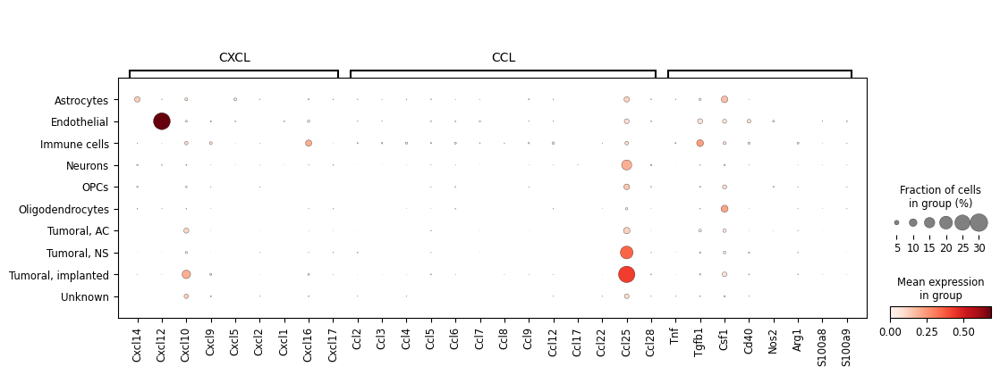

In [40]:
cytokines = {
    'CXCL':['Cxcl14','Cxcl12','Cxcl10','Cxcl9','Cxcl5','Cxcl2','Cxcl1','Cxcl16','Cxcl17'],
    'CCL':['Ccl2','Ccl3','Ccl4','Ccl5','Ccl6','Ccl7','Ccl8','Ccl9','Ccl12', 'Ccl17', 'Ccl22','Ccl25','Ccl28'],
#     'IL':['Il12a','Il10','Il7','Il6','Il4','Il1a','Il1b','Il22','Il23a','Il33','Il34','Il1rn','Il17b','Il17c','Il17d','Il17f'],
#     'TAFA':['Tafa1','Tafa2','Tafa4','Tafa5'],
    '':['Cx3cl1','Cx3cr1','Xcr1','Ackr1','Ccrl2'],
    '':['Tnf','Tgfb1','Csf1','Cd40','Nos2','Arg1','S100a8','S100a9']
}
# KeyError: "Could not find keys '['Cxcl11', 'Cxcl13', 'Cxcl15', 'Cxcl3', 'Cxcl4', 'Cxcl6', 'Cxcl7', 'Cxcl8','Cxcl15']' in columns of `adata.obs` or in adata.raw.var_names."
# KeyError: "Could not find keys '['Ccl1','Ccl10', 'Ccl11', 'Ccl13', 'Ccl14', 'Ccl15','Ccl16', Ccl18', 'Ccl19', 'Ccll20','Ccl21','Ccl23', 'Ccl24', 'Ccl26', 'Ccl27','Ccl3l1']' in columns of `adata.obs` or in adata.raw.var_names."
# KeyError: "Could not find keys '['Il17a', 'Il3', 'Il12b', 'Il8', 'Il9','Il12b', 'Il20', 'Il21', 'Il24','Il25','Il26','Il30','Il31','Il32','Il36a', 'Il36b','Il36g', 'Il36rn','Il37','Il1f10']' in columns of `adata.obs` or in adata.raw.var_names."
# KeyError: "Could not find keys '['Tafa3']' in columns of `adata.obs` or in adata.raw.var_names."
# KeyError: "Could not find keys '['Xcl1','Xcl2','Ccr12p']' in columns of `adata.obs` or in adata.raw.var_names."
# KeyError: "Could not find keys '['Ifng','Csf2']' in columns of `adata.obs` or in adata.raw.var_names."


dp = sc.pl.dotplot(adata, cytokines, 'annotations', dendrogram=False, swap_axes=False)


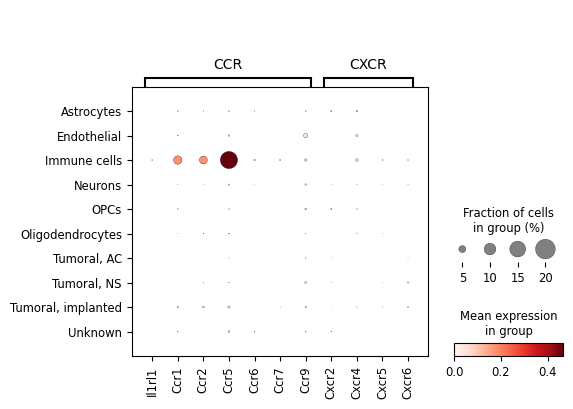

In [43]:
receptors = {
    'CCR':['Il1rl1','Ccr1','Ccr2','Ccr5','Ccr6','Ccr7','Ccr9'],
    'CXCR':['Cxcr2','Cxcr4','Cxcr5','Cxcr6','Cxcr'],
#     'ILR':['Il1r1','Il1r2','Il2ra','Il2rb','Il2rg','Il2rg','Il2rg','Il3ra','Il5ra','Il6st','Il7r','Il10ra','Il10rb','Il12rb1','Il12rb2','Il13ra1','Il15ra','Il17ra','Il17rb','Il17rc','Il17rd','Il17re','Il18r1','Il20ra','Il20rb', 'Il21r', 'Il27ra', 'Il31ra']
    }
# KeyError: "Could not find keys '['Cxcr1','Cxcr3']' in columns of `adata.obs` or in adata.raw.var_names."
# KeyError: "Could not find keys '['Ccr3', 'Ccr4', 'Ccr8']' in columns of `adata.obs` or in adata.raw.var_names."
# KeyError: "Could not find keys '['Il4r', 'Il6r', 'Il11ra', 'Il9r', 'Il13ra2', 'Il22ra1', 'Il22ra2']' in columns of `adata.obs` or in adata.raw.var_names."


dp = sc.pl.dotplot(adata, receptors, 'annotations', dendrogram=False, swap_axes=False)


Cluster: GOBP Positive Regulation of Microglial Cell Activation


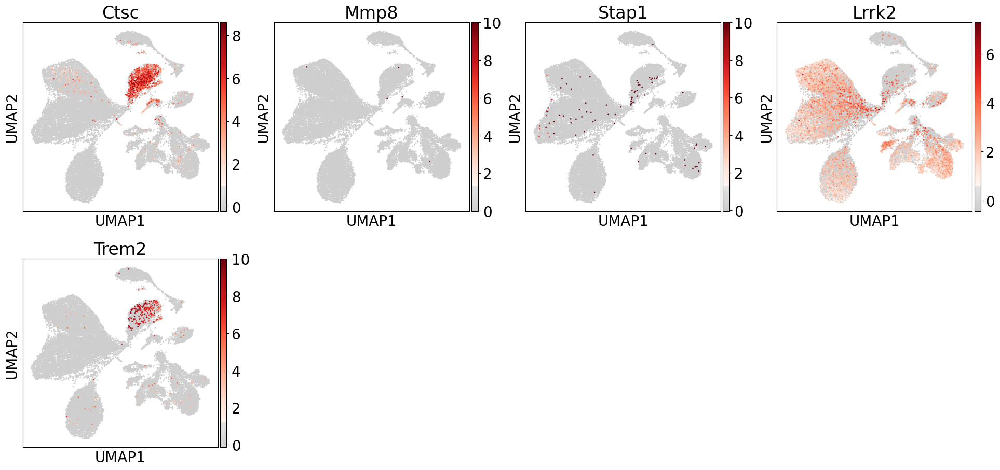

Cluster: GOBP Positive Regulation of Microglial Cell Migration


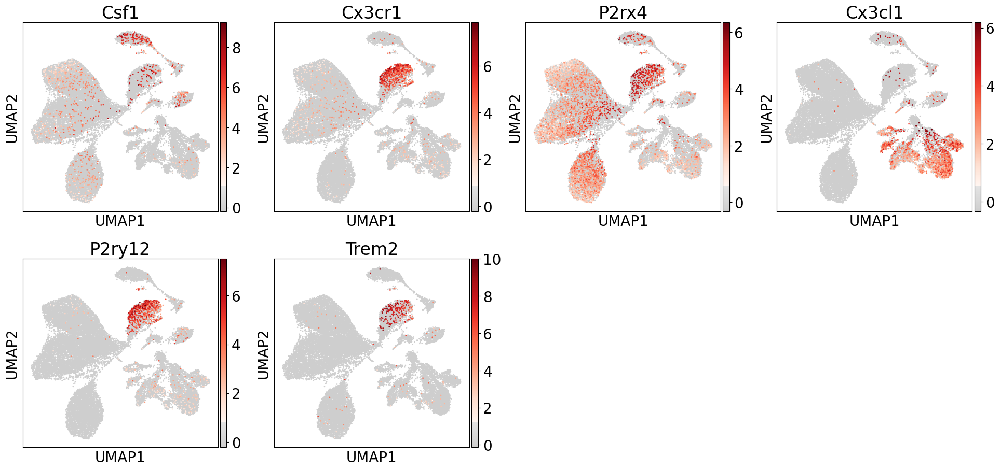

Cluster: GOBP Microglia Differentiation


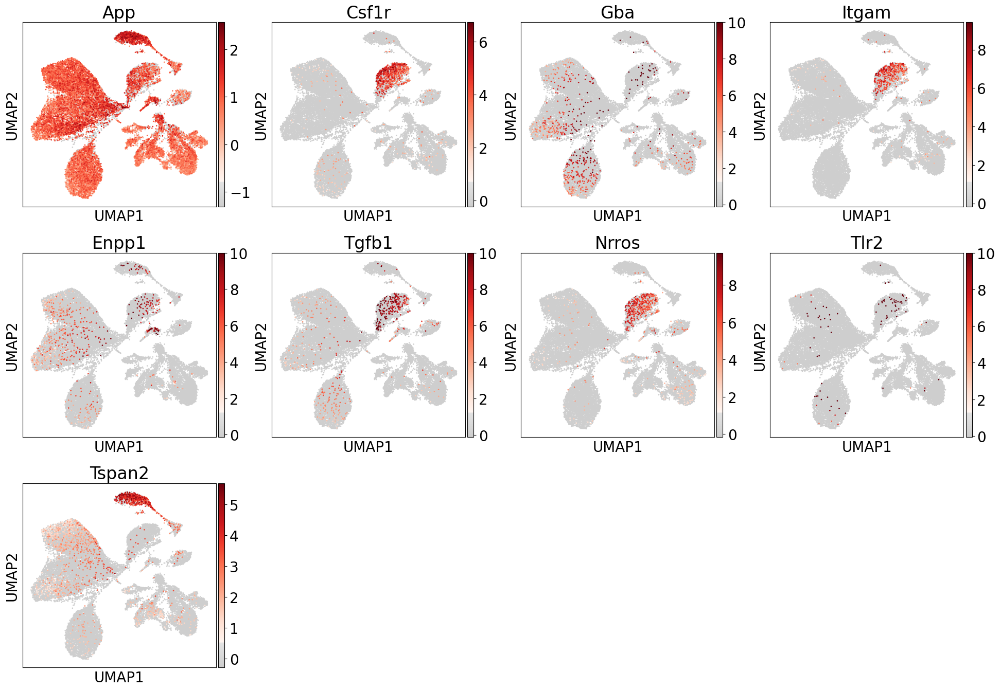

Cluster: WP Microglia Pathogen Phagocytosis Pathway


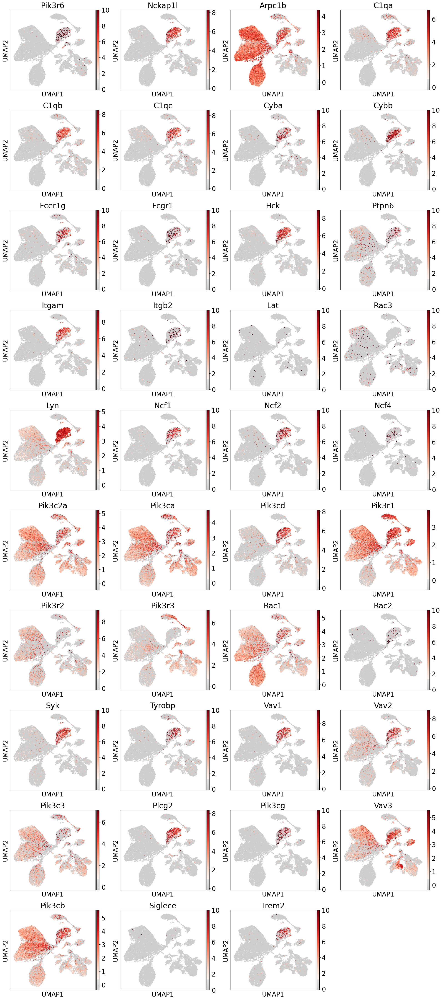

In [7]:
microglia = {
    'GOBP Positive Regulation of Microglial Cell Activation': ['Tbtk1','Ctsc','Mmp8','Tafa3','Stap1','Lrrk2','Trem2'],
    'GOBP Positive Regulation of Microglial Cell Migration':['Csf1','Cx3cr1','P2rx4','Cx3cl1','P2ry12','Trem2'],
    'GOBP Microglia Differentiation':['App','Csf1r','Gba','Itgam','Enpp1','Tgfb1','Nrros','Tlr2','Tspan2'],
    'WP Microglia Pathogen Phagocytosis Pathway':['Pik3r6','Nckap1l','Arpc1b','C1qa','C1qb','C1qc','Cyba','Cybb','Fcer1g','Fcgr1','Hck','Ptpn6','Itgam','Itgb2','Lat','Rac3','Lyn','Ncf1','Ncf2','Ncf4','Pik3c2a','Pik3ca','Pik3cd','Pik3r1','Pik3r2','Pik3r3','Rac1','Rac2','Syk','Tyrobp','Vav1','Vav2','Pik3c3','Plcg2','Pik3cg','Vav3','Trem1','Trem3','Pik3cb','Siglece','Trem2']
}

for i in microglia.keys():
    print(f'Cluster: {i}')
    genes_to_plot = [i for i in microglia[i] if i in adata.var_names]
    with rc_context({'font.size': 20.0,'figure.figsize': (5, 5)}):
        sc.pl.umap(adata, color=genes_to_plot, color_map=mymap_reds,
                   ncols=4, size=15, use_raw=False)

-----

In [4]:
adata = sc.read('./data/3GEX_control_processed_cnv_annotated.h5ad')

In [5]:
adata

AnnData object with n_obs × n_vars = 28833 × 21357
    obs: 'site', 'sample', 'sample_type', 'time', 'treatment', 'sample_t', 'sample_r', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_counts', 'n_genes', 'leiden', 'doublet_score', 'predicted_doublet', 'S_score', 'G2M_score', 'phase', 'tumor 7d', 'cnv_leiden', 'cnv_score', 'cnv_status', 'annotations', 'leiden_res1', 'leiden_res2', 'leiden_res3'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'mean', 'std', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'chromosome', 'start', 'end'
    uns: 'annotations_colors', 'cnv', 'cnv_leiden_colors', 'cnv_neighbors', 'cnv_sta

In [6]:
adata = adata[adata.obs['annotations']==('Immune')]
adata = adata[adata.obs['time'].isin(['7d','28d'])]

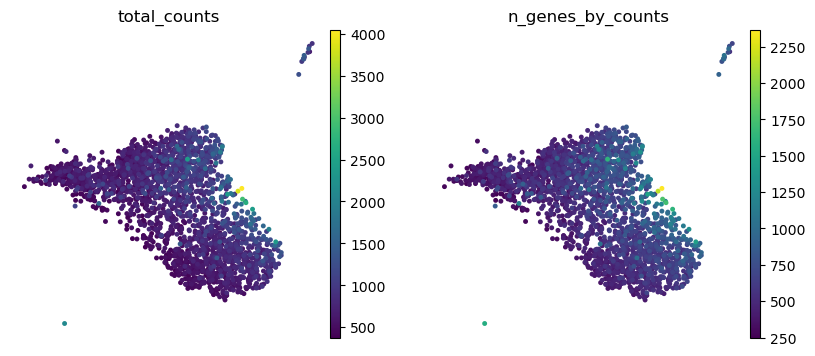

In [7]:
with rc_context({'font.size': 10.0,'figure.figsize': (4, 4)}):
    sc.pl.umap(adata, color=['total_counts','n_genes_by_counts'], size=50, frameon=False)

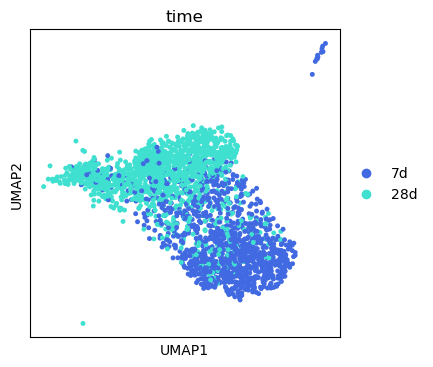

In [14]:
with rc_context({'font.size': 10.0,'figure.figsize': (4, 4)}):
    sc.pl.umap(adata, color=['time'],palette=['royalblue','turquoise'], size=50, frameon=True)

In [19]:
sc.tl.leiden(adata, resolution=0.2, key_added='leiden_immune')

In [443]:
set(adata.obs[y])

{'28d', '7d'}

In [448]:
list(set(adata.obs[y]))

['7d', '28d']

In [474]:
x = 'leiden_immune'
y = 'time'

df = pd.DataFrame(columns=list(set(adata.obs[y])))
for a in set(adata.obs[x]):
    c = adata[adata.obs[x]== a]
    c = pd.DataFrame(c.obs[y].value_counts()).rename(columns={y:a})
    c = c.transpose().rename_axis('Cluster').reset_index()
    df = pd.concat([df,c], axis=0)
    
total = pd.DataFrame(adata.obs[x].value_counts()).rename(columns={x:'Total'})
total = total.rename_axis('Cluster').reset_index()

df = pd.merge(df, total).set_index('Cluster')

In [475]:
df

,7d,28d,Total
Cluster,,,
2,23,431,454
1,439,129,568
0,591,672,1263
3,37,93,130


In [476]:
df = df.rename(columns={'28d':'late','7d':'early'})

In [477]:
percent = pd.DataFrame(df.early.div(df.Total, axis=0).mul(100))
percent.columns = ['Early']
df = pd.concat([df,percent], axis=1)

percent = pd.DataFrame(df.late.div(df.Total, axis=0).mul(100))
percent.columns = ['Late']
df = pd.concat([df,percent], axis=1)

percent = df[['Early','Late']]

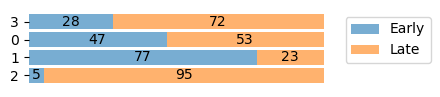

In [478]:
ax = percent.plot(kind='barh', stacked=True, figsize=(4, 1), width=0.8, alpha=0.6)

for c in ax.containers:
    # customize the label to account for cases when there might not be a bar section
    labels = [f'{w:.0f}' if (w := v.get_width()) > 0 else '' for v in c ]
    # set the bar label
    ax.bar_label(c, labels=labels, label_type='center')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.get_xaxis().set_ticks([])
ax.set_ylabel('')

ax.legend(bbox_to_anchor=(1, 1), loc='upper left')

plt.show()

In [484]:
x = 'time'
y = 'leiden_immune'

df = pd.DataFrame(columns=list(set(adata.obs[y])))
for a in set(adata.obs[x]):
    c = adata[adata.obs[x]== a]
    c = pd.DataFrame(c.obs[y].value_counts()).rename(columns={y:a})
    c = c.transpose().rename_axis('Time').reset_index()
    df = pd.concat([df,c], axis=0)
    
total = pd.DataFrame(adata.obs[x].value_counts()).rename(columns={x:'Total'})
total = total.rename_axis('Time').reset_index()

df = pd.merge(df, total).set_index('Time')

In [485]:
df

,2,1,0,3,Total
Time,,,,,
7d,23,439,591,37,1090
28d,431,129,672,93,1325


In [486]:
percent = pd.DataFrame(df['3'].div(df.Total, axis=0).mul(100))
percent.columns = ['% 3']
df = pd.concat([df,percent], axis=1)


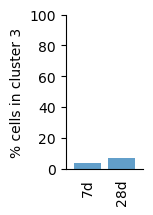

In [496]:
data = df['% 3']
ax = data.plot(kind='bar', stacked=False, figsize=(1, 2), width=0.8, alpha=0.7)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.spines['left'].set_visible(True)
ax.set_ylim(0, 100)
# ax.set_xticklabels(['10x nuclei','10x cells','Smart-Seq'], rotation=90)
ax.tick_params(bottom = False)
ax.set_ylabel('% cells in cluster 3')
ax.set_xlabel('')
plt.show()

In [9]:
micro_act = ['Tbtk1','Ctsc','Mmp8','Tafa3','Stap1','Lrrk2','Trem2'] #GOBP Positive Regulation of Microglial Cell Activation
micro_migr = ['Csf1','Cx3cr1','P2rx4','Cx3cl1','P2ry12','Trem2'] #GOBP Positive Regulation of Microglial Cell Migration
micro_dif = ['App','Csf1r','Gba','Itgam','Enpp1','Tgfb1','Nrros','Tlr2','Tspan2'] #GOBP Microglia Differentiation
micro_phag = ['Pik3r6','Nckap1l','Arpc1b','C1qa','C1qb','C1qc','Cyba','Cybb','Fcer1g','Fcgr1','Hck','Ptpn6','Itgam','Itgb2','Lat','Rac3','Lyn','Ncf1','Ncf2','Ncf4','Pik3c2a','Pik3ca','Pik3cd','Pik3r1','Pik3r2','Pik3r3','Rac1','Rac2','Syk','Tyrobp','Vav1','Vav2','Pik3c3','Plcg2','Pik3cg','Vav3','Trem1','Trem3','Pik3cb','Siglece','Trem2'] #WP Microglia Pathogen Phagocytosis Pathway

In [10]:
sc.tl.score_genes(adata, micro_act, score_name='micro_act')
sc.tl.score_genes(adata, micro_migr, score_name='micro_migr')
sc.tl.score_genes(adata, micro_dif, score_name='micro_dif')
sc.tl.score_genes(adata, micro_phag, score_name='micro_phag')


/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:175: ImplicitModificationWarning:

Trying to modify attribute `.obs` of view, initializing view as actual.



/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.



AttributeError: 'list' object has no attribute 'tick_params'

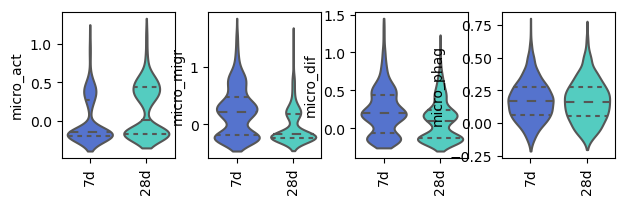

In [21]:
with rc_context({'font.size': 10.0,'figure.figsize': (2.5, 2)}):
    ax = sc.pl.violin(adata, ['micro_act','micro_migr','micro_dif','micro_phag'], stripplot=False, groupby = 'time', rotation=90, inner='quartile',
                        show=False)
    ax.tick_params(bottom=False)
    ax.set(xticklabels=[])
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    
#     plt.savefig(f'./figures/ifng_score.png', bbox_inches='tight', dpi=300)

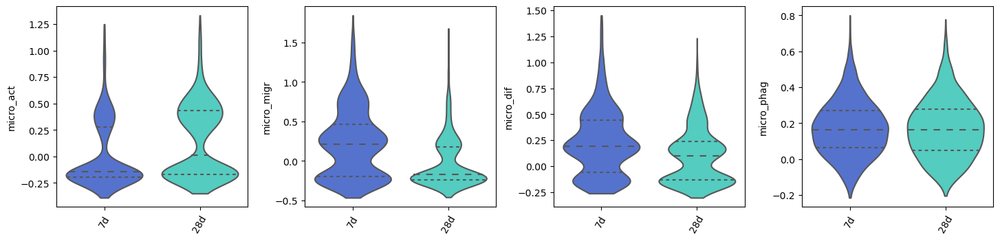

In [24]:
with rc_context({'font.size': 10.0,'figure.figsize': (4, 4)}):
    sc.pl.violin(adata, ['micro_act','micro_migr','micro_dif','micro_phag'],
             stripplot=False, jitter=0.4, size=0.4, groupby = 'time', rotation=60, inner='quartile',
                )

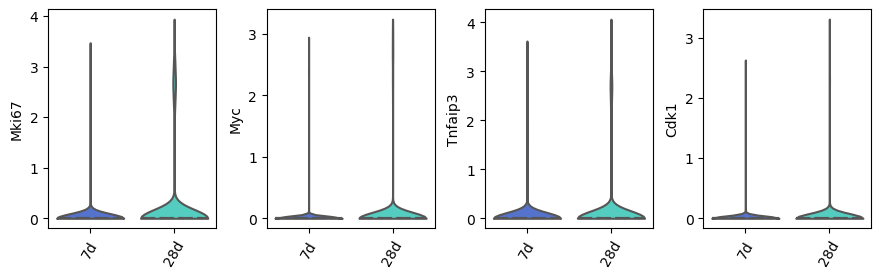

In [16]:
with rc_context({'font.size': 10.0,'figure.figsize': (3, 3)}):
    sc.pl.violin(adata, ['Mki67','Myc','Tnfaip3','Cdk1'],
             stripplot=False, jitter=0.4, size=0.4, groupby = 'time', rotation=60, inner='quartile',
                )

In [ ]:
with rc_context({'font.size': 10.0,'figure.figsize': (3, 3)}):
    sc.pl.violin(adata, ['Mki67','Myc','Tnfaip3','Cdk1'],
             stripplot=False, jitter=0.4, size=0.4, groupby = 'time', rotation=60, inner='quartile',
                )

In [8]:
# load cell cycle genes
cell_cycle_genes = [x.strip() for x in open('/mnt/ibm_lg/laura.garcia/glioblastoma/analysis/pilot/multiome/cell_cycle/cell_cycle_genes.txt')]

# Define sets of genes
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]

sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

/tmp/ipykernel_65631/3347309550.py:2: ResourceWarning:

unclosed file <_io.TextIOWrapper name='/mnt/ibm_lg/laura.garcia/glioblastoma/analysis/pilot/multiome/cell_cycle/cell_cycle_genes.txt' mode='r' encoding='UTF-8'>

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning:

Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.



In [9]:
set(adata.obs['leiden_control_res7'])

{'1,0', '1,1', '1,2'}

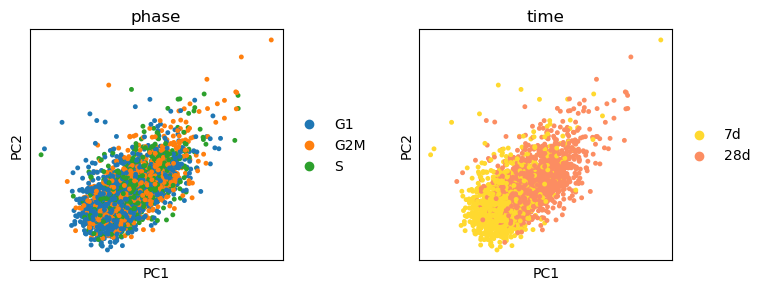

In [18]:
with rc_context({'font.size': 10.0,'figure.figsize': (3, 3)}):
    sc.pl.pca(adata, color=['phase','time'], wspace=0.4)

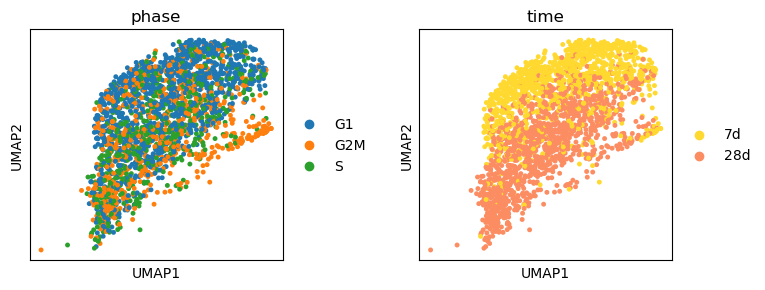

In [19]:
with rc_context({'font.size': 10.0,'figure.figsize': (3, 3)}):
    sc.pl.umap(adata, color=['phase','time'], wspace=0.4)

In [66]:
total = pd.DataFrame(adata.obs['time'].value_counts())
total = total.rename(columns={'time':'total'})

early = adata[adata.obs['time']=='7d']
early = pd.DataFrame(early.obs['phase'].value_counts())
early = early.rename(columns={'phase':'7d'})
early = early.transpose()

late = adata[adata.obs['time']=='28d']
late = pd.DataFrame(late.obs['phase'].value_counts())
late = late.rename(columns={'phase':'28d'})
late = late.transpose()

df = pd.concat([early,late])
df = pd.concat([df,total], axis=1) 

percent = pd.DataFrame(df.G1.div(df.total, axis=0).mul(100).round(1))
percent.columns = ['G1 percent']
df = pd.concat([df,percent], axis=1)

percent = pd.DataFrame(df.G2M.div(df.total, axis=0).mul(100).round(1))
percent.columns = ['G2M percent']
df = pd.concat([df,percent], axis=1)

percent = pd.DataFrame(df.S.div(df.total, axis=0).mul(100).round(1))
percent.columns = ['S percent']
df = pd.concat([df,percent], axis=1)

In [67]:
percent = df[['G1 percent','G2M percent','S percent']]
percent = percent.rename(columns={'G1 percent':'G1','G2M percent':'G2M','S percent':'S'})
# percent = percent.astype(int)

In [68]:
percent

,G1,G2M,S
7d,64.4,18.3,17.3
28d,33.1,36.1,30.8


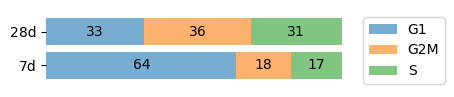

In [72]:
ax = percent.plot(kind='barh', stacked=True, figsize=(4, 1), width=0.8, alpha=0.6)

for c in ax.containers:
    # customize the label to account for cases when there might not be a bar section
    labels = [f'{w:.0f}' if (w := v.get_width()) > 0 else '' for v in c ]
    # set the bar label
    ax.bar_label(c, labels=labels, label_type='center')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.get_xaxis().set_ticks([])
ax.set_ylabel('')

ax.legend(bbox_to_anchor=(1, 1), loc='upper left')

plt.show()

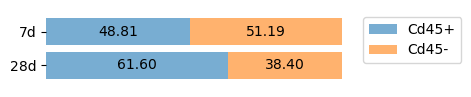

In [155]:
total = pd.DataFrame(adata.obs['time'].value_counts())
total = total.rename(columns={'time':'Total'})[:4]

cd45_pos = pd.DataFrame(adata[adata[: , 'Ptprc'].X > 0, :].obs['time'].value_counts())
cd45_pos = cd45_pos.rename(columns={'time':'Cd45pos'})[:4]

cd45_neg = pd.DataFrame(adata[adata[: , 'Ptprc'].X <= 0, :].obs['time'].value_counts())
cd45_neg = cd45_neg.rename(columns={'time':'Cd45neg'})[:4]

df = pd.concat([total,cd45_pos,cd45_neg], axis=1)
percent = pd.DataFrame(df.Cd45pos.div(df.Total, axis=0).mul(100).round(2))
percent.columns = ['%Cd45pos']
df = pd.concat([df,percent], axis=1)

percent = pd.DataFrame(df.Cd45neg.div(df.Total, axis=0).mul(100).round(2))
percent.columns = ['%Cd45neg']
df = pd.concat([df,percent], axis=1)

percent = df[['%Cd45pos','%Cd45neg']]
percent = percent.rename(columns={'%Cd45pos':'Cd45+','%Cd45neg':'Cd45-'})

ax = percent.plot(kind='barh', stacked=True, figsize=(4, 1), width=0.8, alpha=0.6)

for c in ax.containers:
    # customize the label to account for cases when there might not be a bar section
    labels = [f'{w:.2f}' if (w := v.get_width()) > 0 else '' for v in c ]
    # set the bar label
    ax.bar_label(c, labels=labels, label_type='center')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.get_xaxis().set_ticks([])
ax.set_ylabel('')

ax.legend(bbox_to_anchor=(1, 1), loc='upper left')

plt.show()

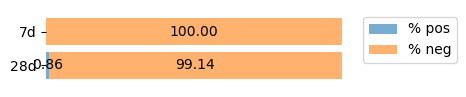

In [167]:
gene = 'Foxp3'
d = adata[adata[: , 'Ptprc'].X > 0, :]

total = pd.DataFrame(d.obs['time'].value_counts())
total = total.rename(columns={'time':'Total'})[:4]

pos = pd.DataFrame(d[d[: , gene].X > 0, :].obs['time'].value_counts())
pos = pos.rename(columns={'time':'pos'})[:4]

neg = pd.DataFrame(d[d[: , gene].X <= 0, :].obs['time'].value_counts())
neg = neg.rename(columns={'time':'neg'})[:4]

df = pd.concat([total,pos,neg], axis=1)
percent = pd.DataFrame(df.pos.div(df.Total, axis=0).mul(100).round(2))
percent.columns = ['% pos']
df = pd.concat([df,percent], axis=1)

percent = pd.DataFrame(df.neg.div(df.Total, axis=0).mul(100).round(2))
percent.columns = ['% neg']
df = pd.concat([df,percent], axis=1)

percent = df[['% pos','% neg']]

ax = percent.plot(kind='barh', stacked=True, figsize=(4, 1), width=0.8, alpha=0.6)

for c in ax.containers:
    # customize the label to account for cases when there might not be a bar section
    labels = [f'{w:.2f}' if (w := v.get_width()) > 0 else '' for v in c ]
    # set the bar label
    ax.bar_label(c, labels=labels, label_type='center')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.get_xaxis().set_ticks([])
ax.set_ylabel('')

ax.legend(bbox_to_anchor=(1, 1), loc='upper left')

plt.show()

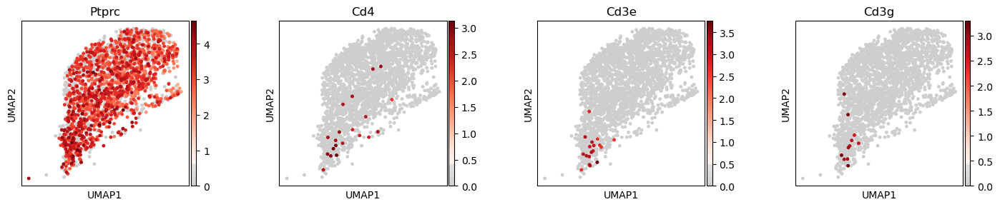

In [14]:
with rc_context({'font.size': 10.0,'figure.figsize': (3, 3)}):
    sc.pl.umap(adata, color=['Ptprc', 'Cd4','Cd3e','Cd3g'], wspace=0.4, cmap=mymap_reds)

In [5]:
sc.tl.rank_genes_groups(adata, groupby='time', key_added='rank_genes_time')


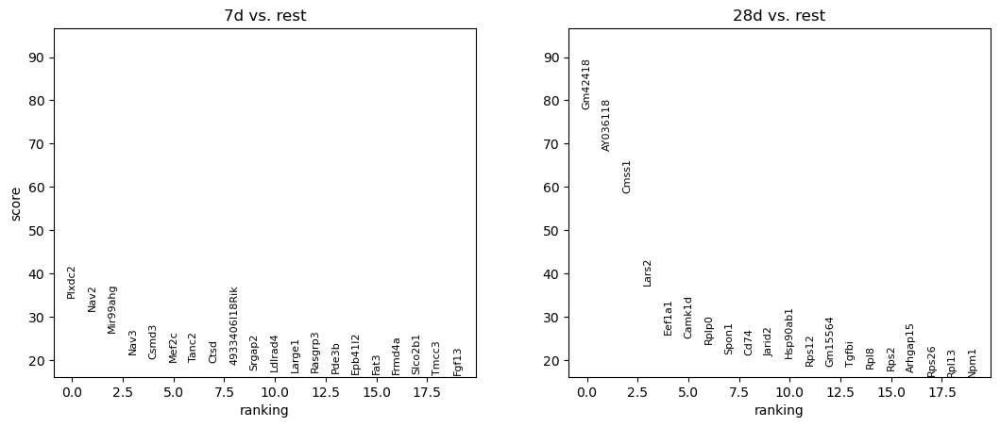

In [7]:
sc.pl.rank_genes_groups(adata, groupby='time', key='rank_genes_time')


In [ ]:
# for i in set(adata.obs['time']):
#     genes_to_plot=sc.get.rank_genes_groups_df(adata, group=i, key='rank_genes_time', pval_cutoff=0.01, log2fc_min=0)['names'][:50].tolist()
#     print(genes_to_plot)

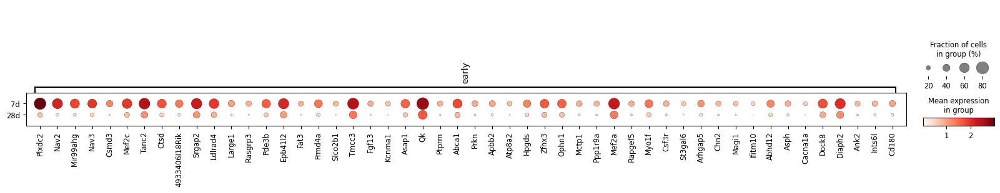

In [150]:
markers = {
    'early':['Plxdc2', 'Nav2', 'Mir99ahg', 'Nav3', 'Csmd3', 'Mef2c', 'Tanc2', 'Ctsd', '4933406I18Rik', 'Srgap2', 'Ldlrad4', 'Large1', 'Rasgrp3', 'Pde3b', 'Epb41l2', 'Fat3', 'Frmd4a', 'Slco2b1', 'Tmcc3', 'Fgf13', 'Kcnma1', 'Asap1', 'Qk', 'Ptprm', 'Abca1', 'Prkn', 'Apbb2', 'Atp8a2', 'Hpgds', 'Zfhx3', 'Ophn1', 'Mctp1', 'Ppp1r9a', 'Mef2a', 'Rapgef5', 'Myo1f', 'Csf3r', 'St3gal6', 'Arhgap5', 'Chn2', 'Magi1', 'Ifitm10', 'Abhd12', 'Asph', 'Cacna1a', 'Dock8', 'Diaph2', 'Ank2', 'Ints6l', 'Cd180']
}

dp = sc.pl.dotplot(adata, markers, 'time', dendrogram=False, swap_axes=False)


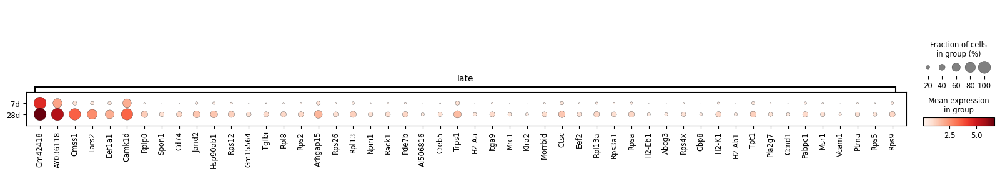

In [151]:
markers = {
    'late':['Gm42418', 'AY036118', 'Cmss1', 'Lars2', 'Eef1a1', 'Camk1d', 'Rplp0', 'Spon1', 'Cd74', 'Jarid2', 'Hsp90ab1', 'Rps12', 'Gm15564', 'Tgfbi', 'Rpl8', 'Rps2', 'Arhgap15', 'Rps26', 'Rpl13', 'Npm1', 'Rack1', 'Pde7b', 'AI506816', 'Creb5', 'Trps1', 'H2-Aa', 'Itga9', 'Mrc1', 'Klra2', 'Morrbid', 'Ctsc', 'Eef2', 'Rpl13a', 'Rps3a1', 'Rpsa', 'H2-Eb1', 'Abcg3', 'Rps4x', 'Gbp8', 'H2-K1', 'H2-Ab1', 'Tpt1', 'Pla2g7', 'Ccnd1', 'Pabpc1', 'Msr1', 'Vcam1', 'Ptma', 'Rps5', 'Rps9']
}

dp = sc.pl.dotplot(adata, markers, 'time', dendrogram=False, swap_axes=False)


In [ ]:
markers = ['Plxdc2','Nav2','']

Time: 7d


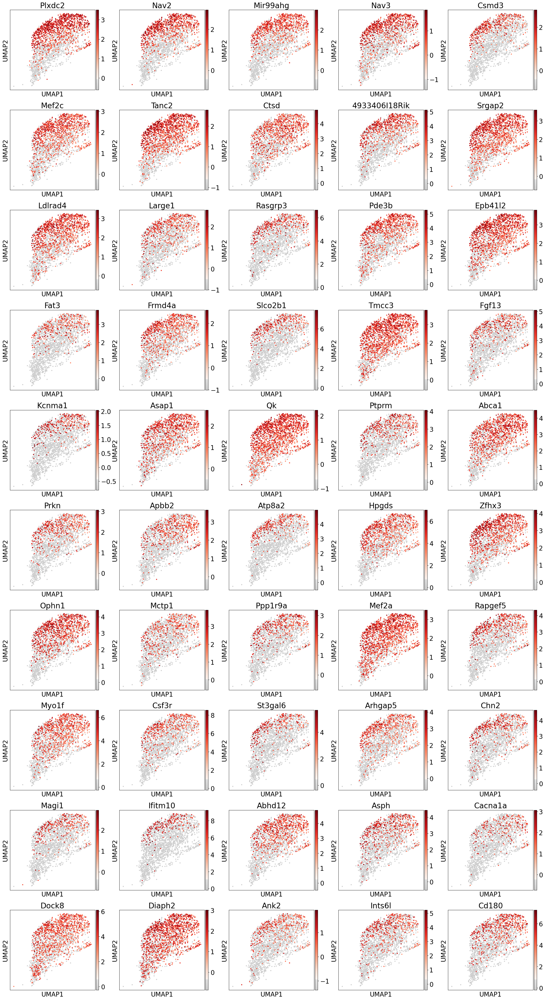

Time: 28d


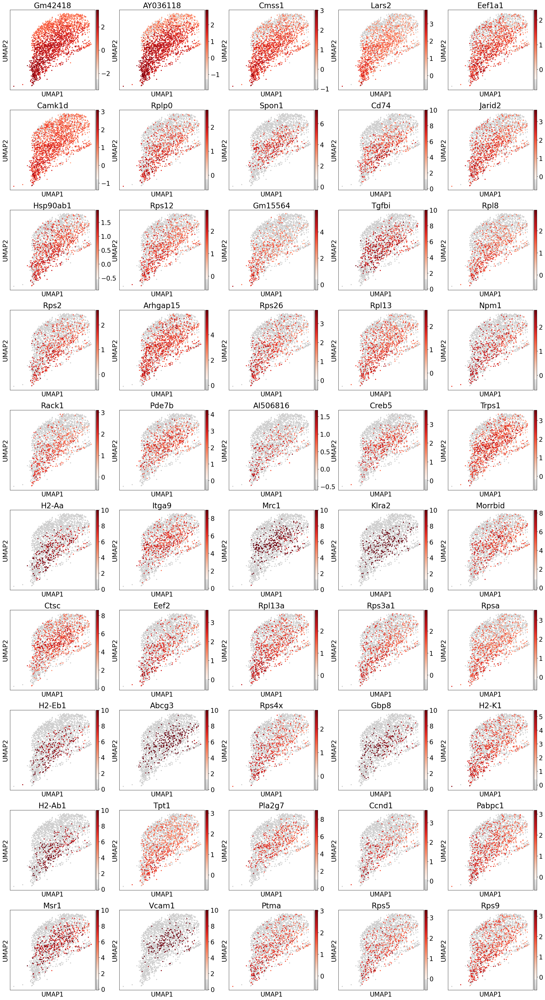

In [154]:
for i in set(adata.obs['time']):
    print(f'Time: {i}')
    genes_to_plot=sc.get.rank_genes_groups_df(adata, group=i, key='rank_genes_time', pval_cutoff=0.01, log2fc_min=0)['names'][:50].tolist()
    with rc_context({'font.size': 20.0,'figure.figsize': (5, 5)}):
        sc.pl.umap(adata, color=genes_to_plot, ncols=5, cmap=mymap_reds, use_raw=False)
        

In [111]:
# scale and store results in layer
adata.layers['scaled'] = sc.pp.scale(adata, copy=True).X

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:784: RuntimeWarning:

invalid value encountered in sqrt



In [118]:
# sc.tl.dendrogram(adata, groupby='time')

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/scanpy/plotting/_anndata.py:2414: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.



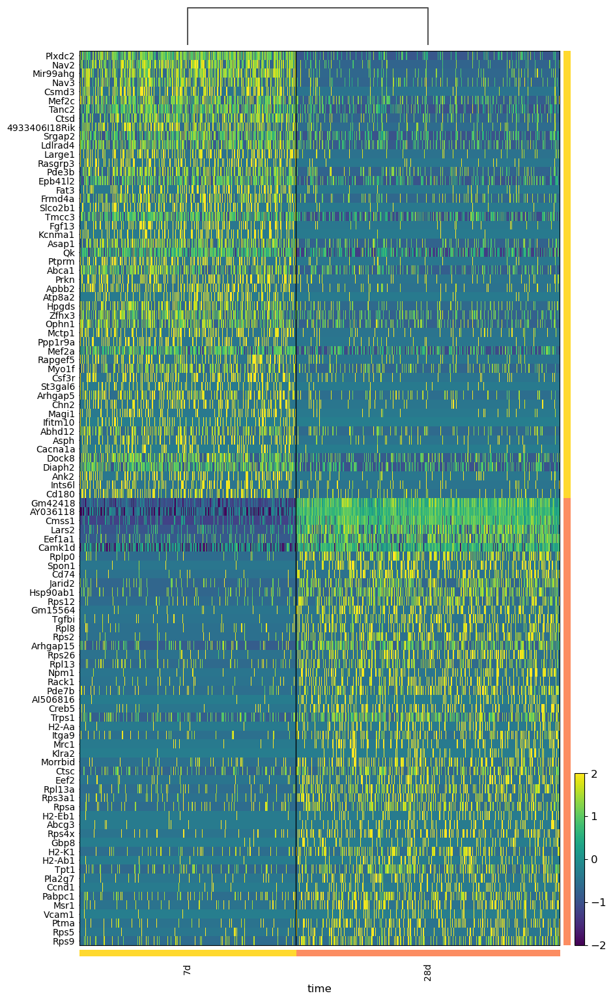

In [129]:
with rc_context({'font.size': 12,'figure.figsize': (10, 20)}):
    sc.pl.rank_genes_groups_heatmap(adata, groupby='time', key='rank_genes_time', show_gene_labels=True,
                                    values_to_plot='logfoldchanges',
                                swap_axes=True, layer='scaled', vmin=-2, vmax=+2, n_genes=50, cmap='viridis',  show=True)


In [130]:
early = sc.get.rank_genes_groups_df(adata, group='7d', key='rank_genes_time', pval_cutoff=0.01, log2fc_min=0)['names']
late = sc.get.rank_genes_groups_df(adata, group='28d', key='rank_genes_time', pval_cutoff=0.01, log2fc_min=0)['names']


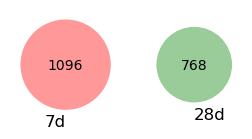

In [133]:
with rc_context({'font.size': 10.0,'figure.figsize': (3,3)}):
    c = venn2([set(early),set(late)], ('7d','28d'),alpha=0.4)
#     c.get_patch_by_id('11').set_color('darkviolet')
#     c.get_patch_by_id('11').set_edgecolor('none')

In [134]:
enr_early_KEGG = gp.enrichr(gene_list=early,
                     organism='Mouse',
                     gene_sets= ['KEGG_2019_Mouse'],
                          cutoff=0.05)
enr_early_KEGG.results

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/gseapy/enrichr.py:141: ResourceWarning:

unclosed <socket.socket fd=68, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('192.168.99.56', 41278), raddr=('52.3.219.125', 80)>

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/gseapy/enrichr.py:141: ResourceWarning:

unclosed <ssl.SSLSocket fd=69, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('192.168.99.56', 58706), raddr=('52.3.219.125', 443)>

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/gseapy/enrichr.py:504: ResourceWarning:

unclosed <socket.socket fd=68, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('192.168.99.56', 41362), raddr=('52.3.219.125', 80)>

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/gseapy/enrichr.py:504: ResourceWarning:

unclosed <ssl.SSLSocket fd=69, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('192.168.99.56', 

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,KEGG_2019_Mouse,Lysosome,26/124,2.712209e-09,7.024620e-07,0,0,4.662941,9.197886e+01,SCARB2;CLTC;HEXA;CLTA;LIPA;GNS;CLN3;NAGLU;CTSL...
1,KEGG_2019_Mouse,Glutamatergic synapse,23/114,4.738955e-08,6.136947e-06,0,0,4.431439,7.473562e+01,GRIA1;GRIA2;PRKCB;SLC1A2;SLC1A3;CACNA1A;ITPR2;...
2,KEGG_2019_Mouse,Synaptic vesicle cycle,18/77,1.301376e-07,1.123521e-05,0,0,5.333323,8.455809e+01,SNAP25;ATP6V0B;RAB3A;SYT1;STXBP1;CLTC;SLC1A2;C...
3,KEGG_2019_Mouse,Platelet activation,21/125,4.149438e-06,2.686761e-04,0,0,3.531306,4.376184e+01,P2RY12;ROCK2;ITGB3;ITPR2;ADCY3;MAPK14;GNAI1;PI...
4,KEGG_2019_Mouse,Retrograde endocannabinoid signaling,23/150,7.239816e-06,3.361279e-04,0,0,3.169207,3.751046e+01,GRIA1;GABRB3;GRIA2;GABRB2;GABRA1;GABRB1;DAGLA;...
...,...,...,...,...,...,...,...,...,...,...
254,KEGG_2019_Mouse,Chemical carcinogenesis,1/94,9.950578e-01,9.999942e-01,0,0,0.184720,9.151958e-04,HPGDS
255,KEGG_2019_Mouse,mRNA surveillance pathway,1/96,9.955867e-01,9.999942e-01,0,0,0.180812,7.997399e-04,PPP2R3A
256,KEGG_2019_Mouse,Spliceosome,1/132,9.994241e-01,9.999942e-01,0,0,0.130872,7.539636e-05,SNRNP70
257,KEGG_2019_Mouse,Herpes simplex virus 1 infection,7/433,9.999862e-01,9.999942e-01,0,0,0.278815,3.854857e-06,IFNAR2;ZFP69;ITGB3;BID;POU2F2;NFKB1;ZFP90


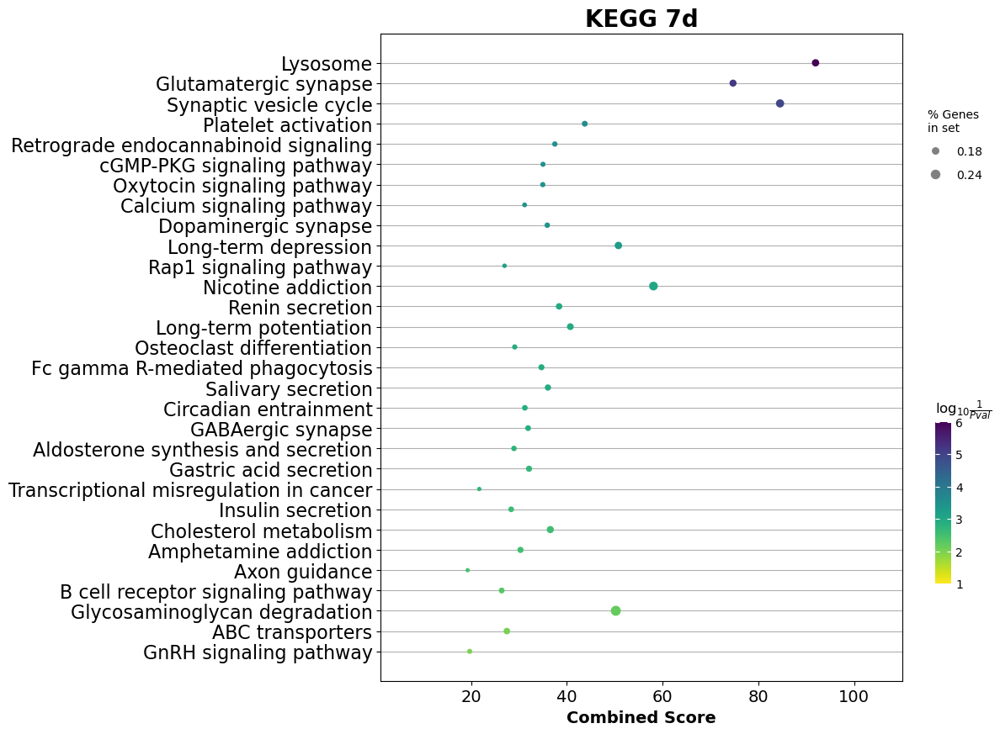

In [136]:
ax = dotplot(enr_early_KEGG.results, 
             top_term=30,
             title='KEGG 7d',
             cmap='viridis_r', 
             size=5, 
             figsize=(10,10))

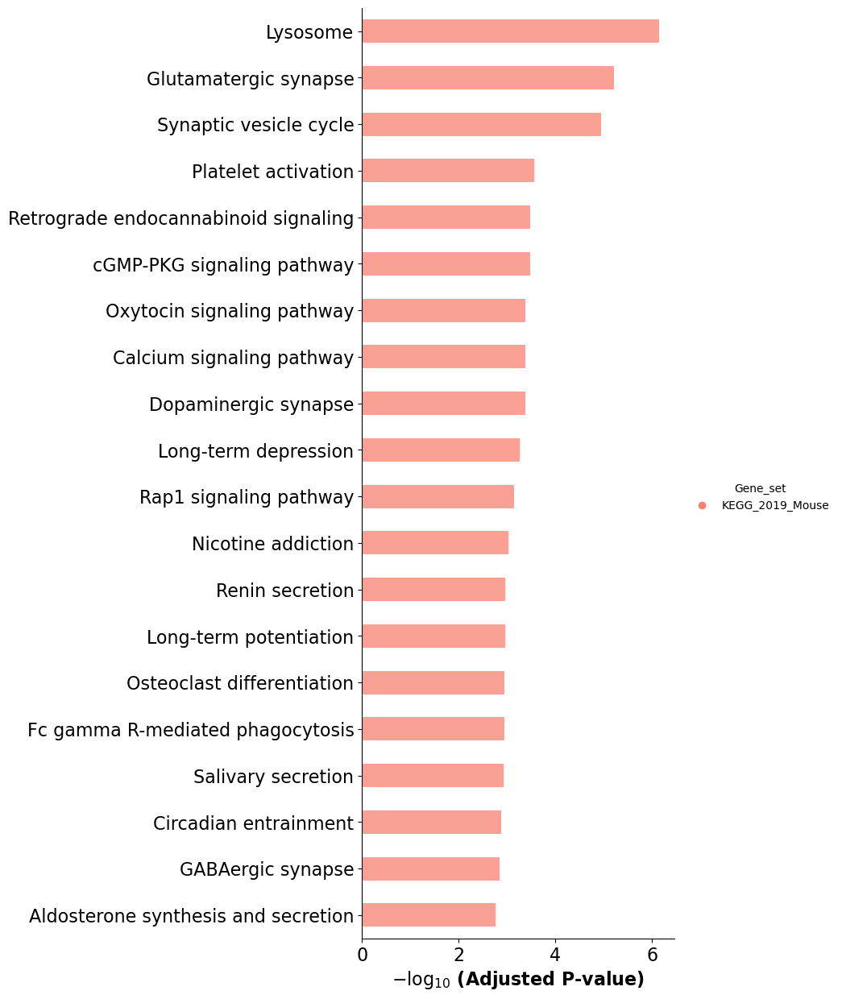

In [142]:
ax = barplot(enr_early_KEGG.results,
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              top_term=20,
              figsize=(5,15),
             )

In [137]:
enr_late_KEGG = gp.enrichr(gene_list=late,
                     organism='Mouse',
                     gene_sets= ['KEGG_2019_Mouse'],
                          cutoff=0.05)
enr_late_KEGG.results

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/gseapy/enrichr.py:141: ResourceWarning:

unclosed <socket.socket fd=71, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('192.168.99.56', 43004), raddr=('52.3.219.125', 80)>

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/gseapy/enrichr.py:141: ResourceWarning:

unclosed <ssl.SSLSocket fd=72, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('192.168.99.56', 60434), raddr=('52.3.219.125', 443)>

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/gseapy/enrichr.py:504: ResourceWarning:

unclosed <socket.socket fd=71, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('192.168.99.56', 43080), raddr=('52.3.219.125', 80)>

/data/laura.garcia/miniconda3/lib/python3.8/site-packages/gseapy/enrichr.py:504: ResourceWarning:

unclosed <ssl.SSLSocket fd=72, family=AddressFamily.AF_INET, type=SocketKind.SOCK_STREAM, proto=6, laddr=('192.168.99.56', 

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,KEGG_2019_Mouse,Ribosome,73/170,8.391236e-58,2.122983e-55,0,0,20.720240,2723.110910,RPL4;RPL5;RPL30;RPL3;RPL32;RPL31;RPLP1;RPLP0;R...
1,KEGG_2019_Mouse,Antigen processing and presentation,23/90,2.752467e-13,3.481871e-11,0,0,8.830913,255.399780,CD74;HSPA8;CIITA;H2-T22;HSP90AA1;H2-EB1;HSP90A...
2,KEGG_2019_Mouse,Epstein-Barr virus infection,32/229,2.604789e-10,2.196705e-08,0,0,4.201059,92.711076,CD40;CDKN1A;H2-T22;PSMD14;H2-DMA;H2-Q6;H2-K1;H...
3,KEGG_2019_Mouse,Viral myocarditis,19/87,6.077887e-10,3.844264e-08,0,0,7.149061,151.711620,CD40;H2-T22;H2-EB1;CD80;H2-DMA;H2-Q6;H2-K1;H2-...
4,KEGG_2019_Mouse,Human T-cell leukemia virus 1 infection,32/245,1.474672e-09,7.461842e-08,0,0,3.882221,78.944301,CD40;CDKN1A;H2-T22;H2-DMA;H2-Q6;H2-K1;H2-Q7;SL...
...,...,...,...,...,...,...,...,...,...,...
248,KEGG_2019_Mouse,Glycerophospholipid metabolism,1/97,9.777950e-01,9.880783e-01,0,0,0.259887,0.005836,AGPAT4
249,KEGG_2019_Mouse,Phosphatidylinositol signaling system,1/98,9.786517e-01,9.880783e-01,0,0,0.257194,0.005550,PI4K2B
250,KEGG_2019_Mouse,Melanogenesis,1/100,9.802674e-01,9.880783e-01,0,0,0.251972,0.005022,TCF7L2
251,KEGG_2019_Mouse,Drug metabolism,1/114,9.886277e-01,9.894890e-01,0,0,0.220593,0.002523,NME2


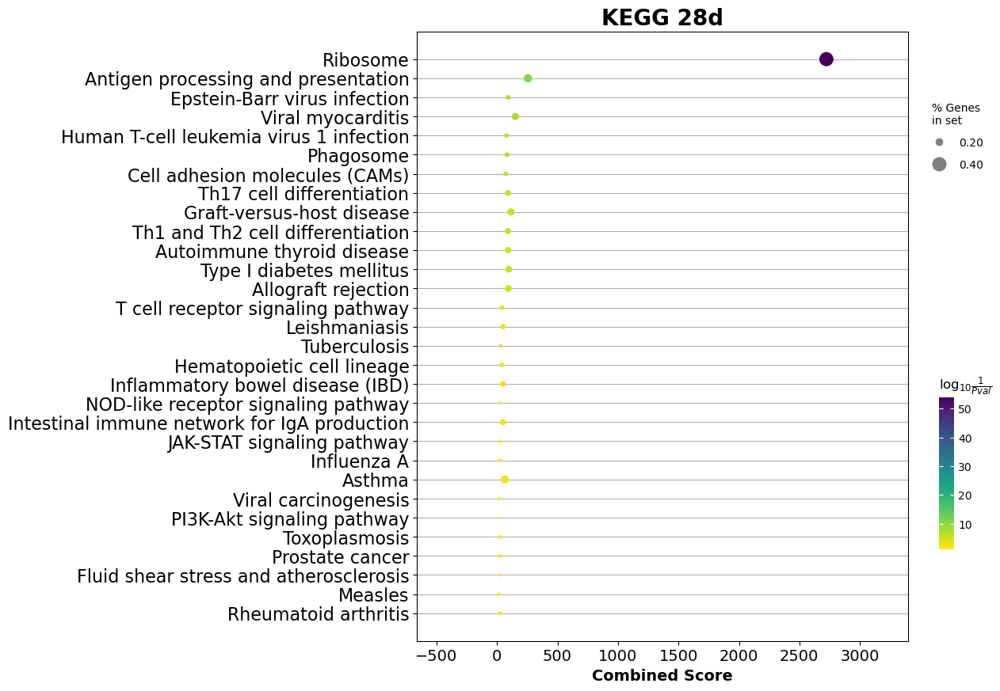

In [138]:
ax = dotplot(enr_late_KEGG.results, 
             top_term=30,
             title='KEGG 28d',
             cmap='viridis_r', 
             size=5, 
             figsize=(10,10))

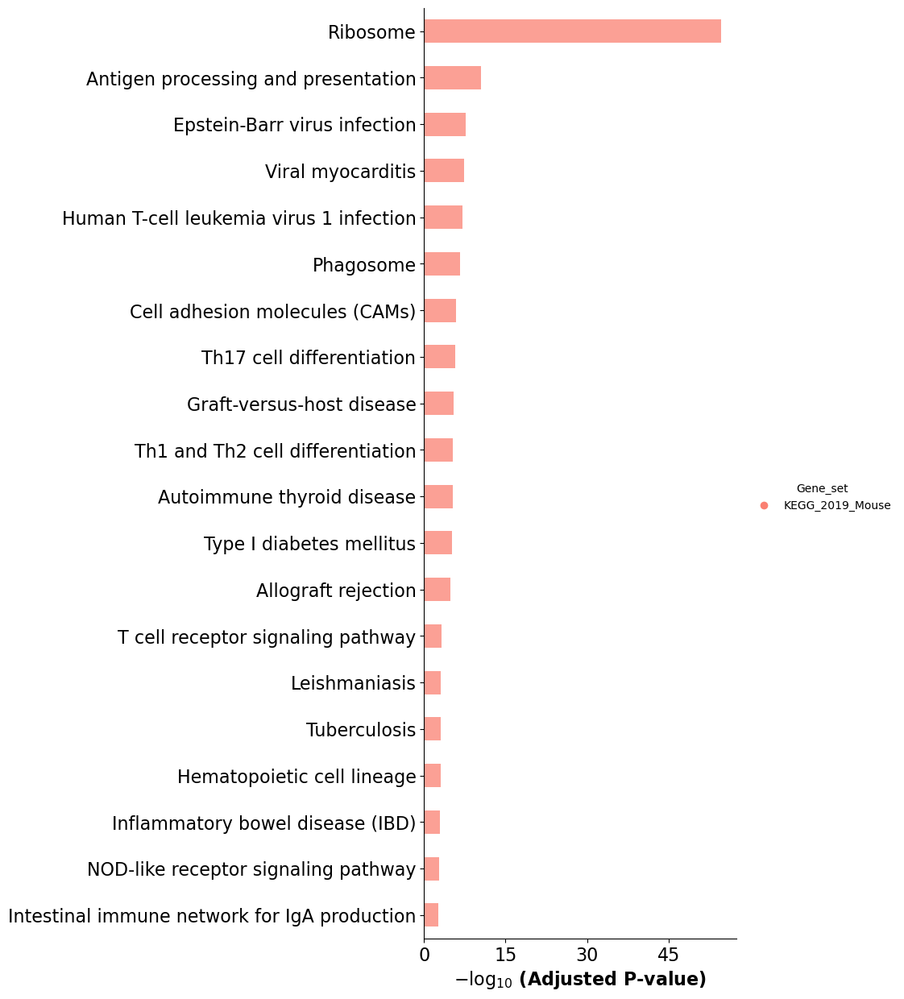

In [143]:
ax = barplot(enr_late_KEGG.results,
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              top_term=20,
              figsize=(5,15),
             )

# Rank

In [4]:
adata = sc.read('./data/3GEX_processed_cnv_control_annotated.h5ad')
adata = adata[adata.obs['annotations']==('Immune cells')]
adata = adata[adata.obs['time'].isin(['7d','28d'])]

In [17]:
sc.tl.rank_genes_groups(adata, groupby='time', key_added='rank_genes_time')

In [18]:
late_rank = sc.get.rank_genes_groups_df(adata, group='28d', key='rank_genes_time')[['names','logfoldchanges']]
late_rank.sort_values(by=['logfoldchanges'], inplace=True, ascending=False)
late_rank = late_rank.apply(lambda x: x.astype(str).str.upper())
late_rank = late_rank.set_index('names')
late_rank = late_rank.astype(np.float64)

In [19]:
# gene_set_names = gp.get_library_name(organism='Mouse')
# print(gene_set_names)

In [36]:
pre_res = gp.prerank(rnk=late_rank,
                     gene_sets='KEGG_2019_Mouse',
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir=None, # don't write to disk
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )


2023-01-26 07:12:33,215 [WARNING] Duplicated values found in preranked stats: 24.21% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2023-01-26 07:12:33,217 [INFO] Parsing data files for GSEA.............................
2023-01-26 07:12:33,219 [INFO] Enrichr library gene sets already downloaded in: /data/laura.garcia/.cache/gseapy, use local file
2023-01-26 07:12:33,240 [INFO] 0002 gene_sets have been filtered out when max_size=1000 and min_size=5
2023-01-26 07:12:33,242 [INFO] 0301 gene_sets used for further statistical testing.....
2023-01-26 07:12:33,243 [INFO] Start to run GSEA...Might take a while..................
2023-01-26 07:12:47,945 [INFO] Congratulations. GSEApy runs successfully................



In [1]:
# pre_res.res2d['Term'][260:]

In [2]:
# pre_res.res2d['Term'].tolist()

In [42]:
pre_res.res2d.to_csv('./Enrichr/immune_28vs7d_prerank_KEGG2019.csv')

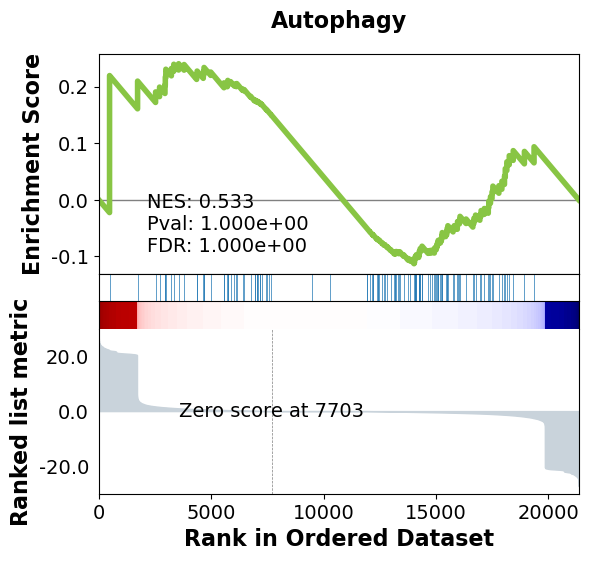

In [61]:
term = ['Autophagy']

for i in term:
    gseaplot(rank_metric=pre_res.ranking,
         term=i,
         **pre_res.results[i])


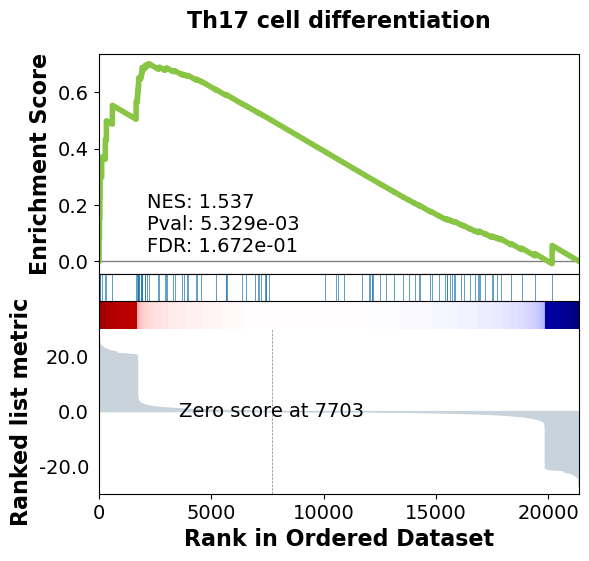

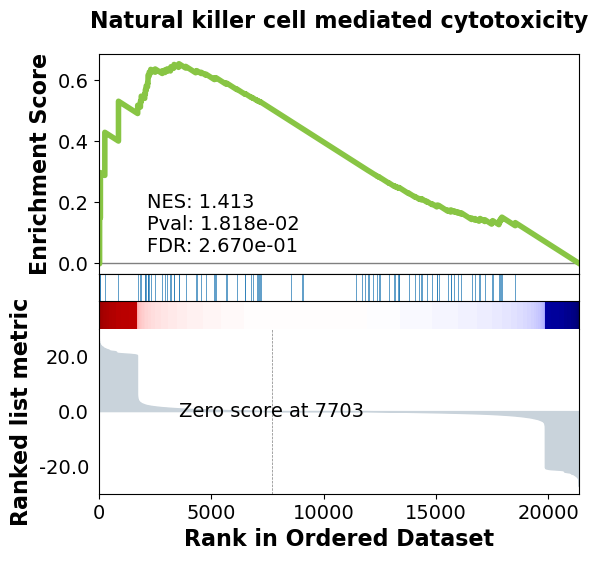

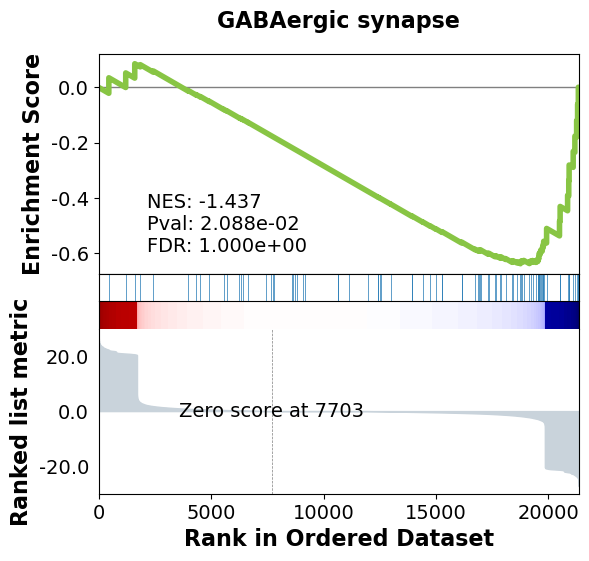

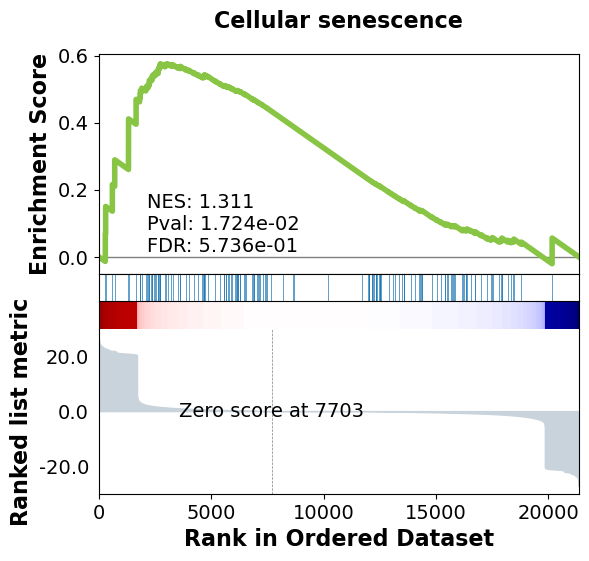

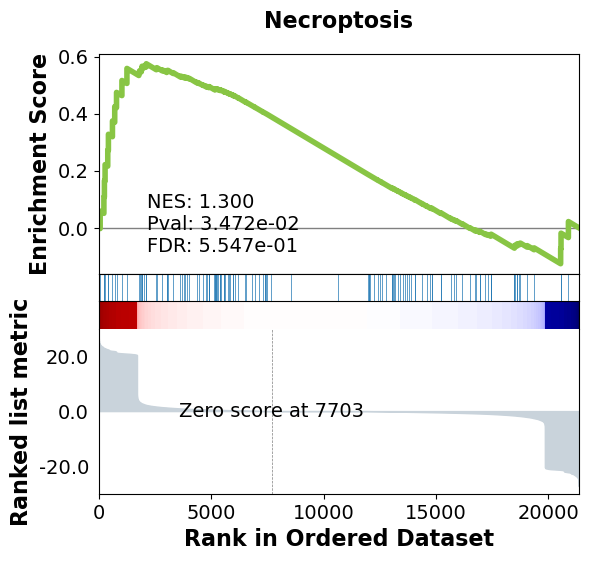

In [50]:
term = ['Th17 cell differentiation','Natural killer cell mediated cytotoxicity','GABAergic synapse','Cellular senescence','Necroptosis']

for i in term:
    gseaplot(rank_metric=pre_res.ranking,
         term=i,
         **pre_res.results[i])


In [25]:
# terms = pre_res.res2d.Term
# i = 1
# # to save your figure, make sure that ofname is not None
# gseaplot(rank_metric=pre_res.ranking,
#          term=terms[i],
#          **pre_res.results[terms[i]])

# # save figure
# # gseaplot(rank_metric=pre_res.ranking, term=terms[0], ofname='your.plot.pdf', **pre_res.results[terms[0]])

In [30]:
from gseapy import enrichment_map
import networkx as nx


In [63]:
# return two dataframe
nodes, edges = enrichment_map(pre_res.res2d)

# build graph
G = nx.from_pandas_edgelist(edges,
                            source='src_idx',
                            target='targ_idx',
                            edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes'])

fig, ax = plt.subplots(figsize=(5, 5),)

# init node cooridnates
pos=nx.layout.spiral_layout(G)
#node_size = nx.get_node_attributes()
# draw node
nx.draw_networkx_nodes(G,
                       pos=pos,
                       cmap=plt.cm.RdYlBu,
                       node_color=list(nodes.NES),
                       node_size=list(nodes.Hits_ratio *1000))
# draw node label
nx.draw_networkx_labels(G,
                        pos=pos,
                        labels=nodes.Term.to_dict())
# draw edge
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(G,
                       pos=pos,
                       width=list(map(lambda x: x*10, edge_weight)),
                       edge_color='#CDDBD4')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

plt.show()

ValueError: Warning: No enrich terms when cutoff = 0.05

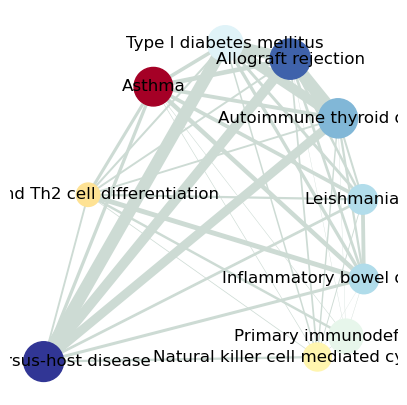

In [64]:
pre_res = gp.prerank(rnk=late_rank,
                     gene_sets='MSigDB_Hallmark_2020',
                     threads=4,
                     min_size=5,
                     max_size=1000,
                     permutation_num=1000, # reduce number to speed up testing
                     outdir=None, # don't write to disk
                     seed=6,
                     verbose=True, # see what's going on behind the scenes
                    )


2023-01-26 07:32:34,322 [WARNING] Duplicated values found in preranked stats: 24.21% of genes
The order of those genes will be arbitrary, which may produce unexpected results.
2023-01-26 07:32:34,324 [INFO] Parsing data files for GSEA.............................
2023-01-26 07:32:34,325 [INFO] Enrichr library gene sets already downloaded in: /data/laura.garcia/.cache/gseapy, use local file
2023-01-26 07:32:34,334 [INFO] 0000 gene_sets have been filtered out when max_size=1000 and min_size=5
2023-01-26 07:32:34,335 [INFO] 0050 gene_sets used for further statistical testing.....
2023-01-26 07:32:34,336 [INFO] Start to run GSEA...Might take a while..................
2023-01-26 07:32:37,780 [INFO] Congratulations. GSEApy runs successfully................



In [65]:
pre_res.res2d.to_csv('./Enrichr/immune_28vs7d_prerank_MSigDB2020.csv')

In [35]:
pre_res.res2d.Term[:50]

0                           E2F Targets
1                   Allograft Rejection
2             Interferon Gamma Response
3                        Myc Targets V1
4                          Angiogenesis
5                       G2-M Checkpoint
6                 Inflammatory Response
7                  IL-2/STAT5 Signaling
8             Interferon Alpha Response
9                            Complement
10                     mTORC1 Signaling
11            Unfolded Protein Response
12              Cholesterol Homeostasis
13                              Hypoxia
14    Epithelial Mesenchymal Transition
15                          p53 Pathway
16                           Myogenesis
17                       UV Response Up
18                      Notch Signaling
19                    KRAS Signaling Dn
20                       Apical Surface
21                       Myc Targets V2
22             IL-6/JAK/STAT3 Signaling
23        TNF-alpha Signaling via NF-kB
24                      Spermatogenesis


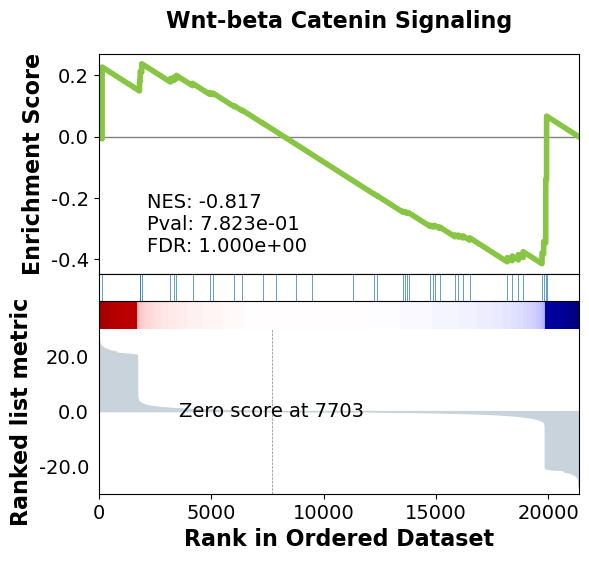

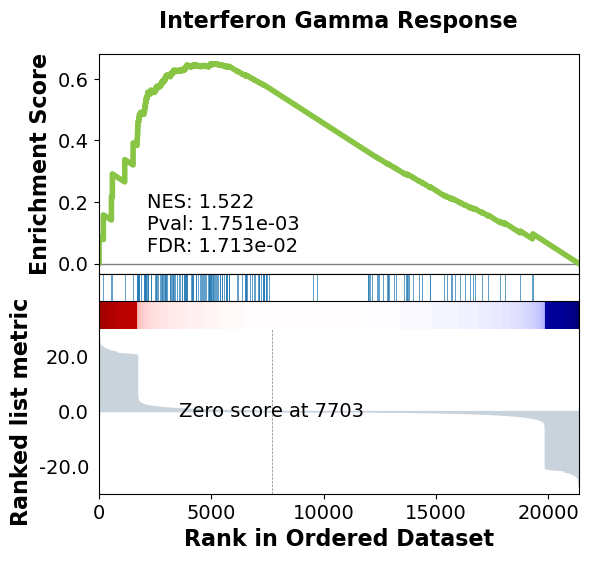

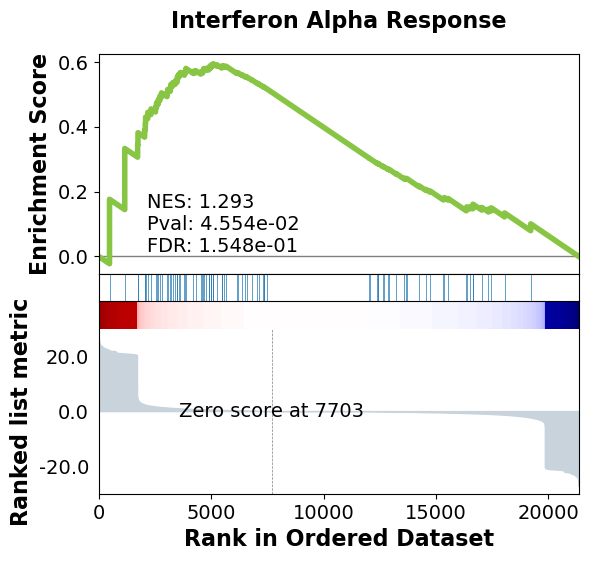

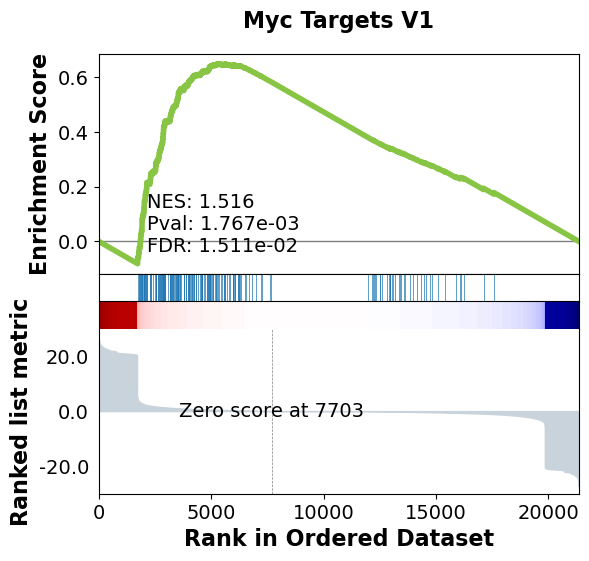

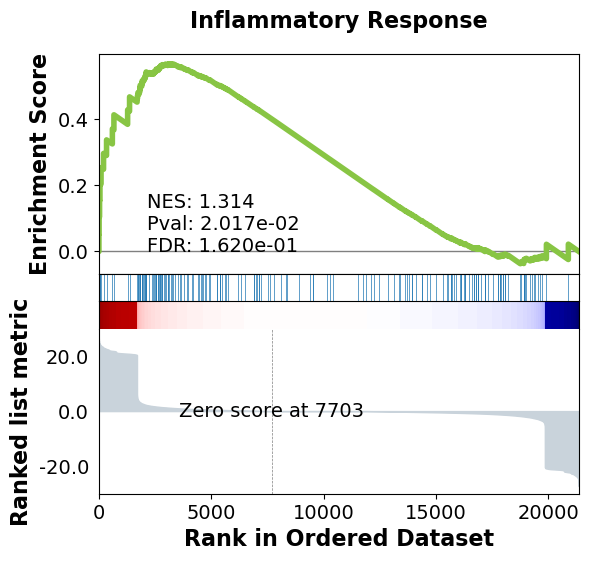

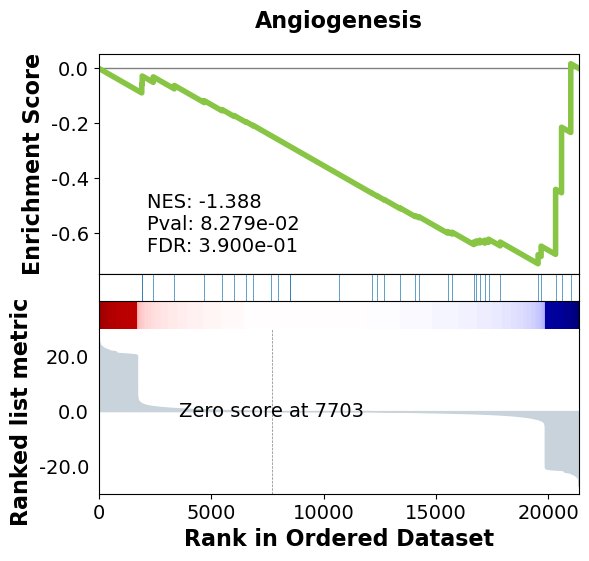

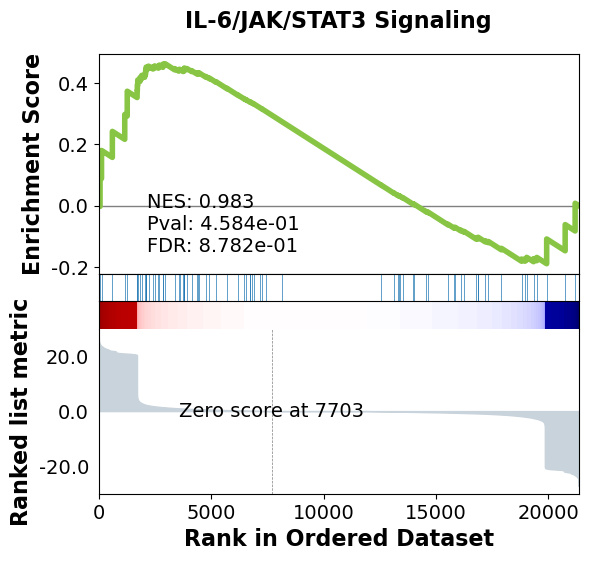

In [68]:
term = ['Wnt-beta Catenin Signaling','Interferon Gamma Response','Interferon Alpha Response','Myc Targets V1','Inflammatory Response','Angiogenesis','IL-6/JAK/STAT3 Signaling' ]

for i in term:
    gseaplot(rank_metric=pre_res.ranking,
         term=i,
         **pre_res.results[i])


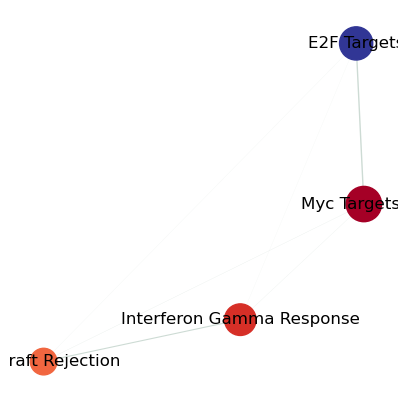

In [34]:
# return two dataframe
nodes, edges = enrichment_map(pre_res.res2d)

# build graph
G = nx.from_pandas_edgelist(edges,
                            source='src_idx',
                            target='targ_idx',
                            edge_attr=['jaccard_coef', 'overlap_coef', 'overlap_genes'])

fig, ax = plt.subplots(figsize=(5, 5),)

# init node cooridnates
pos=nx.layout.spiral_layout(G)
#node_size = nx.get_node_attributes()
# draw node
nx.draw_networkx_nodes(G,
                       pos=pos,
                       cmap=plt.cm.RdYlBu,
                       node_color=list(nodes.NES),
                       node_size=list(nodes.Hits_ratio *1000))
# draw node label
nx.draw_networkx_labels(G,
                        pos=pos,
                        labels=nodes.Term.to_dict())
# draw edge
edge_weight = nx.get_edge_attributes(G, 'jaccard_coef').values()
nx.draw_networkx_edges(G,
                       pos=pos,
                       width=list(map(lambda x: x*10, edge_weight)),
                       edge_color='#CDDBD4')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)

plt.show()